In [42]:
import pandas as pd
import numpy as np
import openpyxl
from openpyxl import load_workbook
from sklearn.preprocessing import MinMaxScaler
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import silhouette_score
from sklearn.cluster import KMeans
from matplotlib.colors import ListedColormap
from datetime import datetime
import matplotlib.pyplot as plt
import seaborn as sns
import os

# Define the list of stimulations, rats, frequencies, files etc.
stim = ['TIS']
rats = ['Trial 240125']
delta_frequencies = [10, 20, 30]
frequency_filenames = [
    # '/Users/shawnyang/Desktop/UofT/ECE2500Y/ece2500Y/csv_coordinates/2nd batch (Trial 240125) - filtered/2-and-2-001-kHz-continuousDLC_resnet50_ece2500yJan17shuffle1_100000_filtered.csv',
    # '/Users/shawnyang/Desktop/UofT/ECE2500Y/ece2500Y/csv_coordinates/2nd batch (Trial 240125) - filtered/2-and-2-002-kHz-continuousDLC_resnet50_ece2500yJan17shuffle1_100000_filtered.csv',
    # '/Users/shawnyang/Desktop/UofT/ECE2500Y/ece2500Y/csv_coordinates/2nd batch (Trial 240125) - filtered/2-and-2-003-kHz-continuousDLC_resnet50_ece2500yJan17shuffle1_100000_filtered.csv'
    ]

## Process files - Change the column name; Normalize; 

In [2]:
# Define new column names
new_column_names = [
    'Time', 'Hip x', 'Hip y', 'Hip likelihood',
    'Knee x', 'Knee y', 'Knee likelihood',
    'Ankle x', 'Ankle y', 'Ankle likelihood',
    'Heel (ventral) x', 'Heel (ventral) y', 'Heel (ventral) likelihood',
    'Instep (dorsal) x', 'Instep (dorsal) y', 'Instep (dorsal) likelihood',
    'Toe 1 (Proximal Thumb) x', 'Toe 1 (Proximal Thumb) y', 'Toe 1 (Proximal Thumb) likelihood',
    'Toe2 x', 'Toe2 y', 'Toe2 likelihood',
    'Toe 3 (Middle) x', 'Toe 3 (Middle) y', 'Toe 3 (Middle) likelihood',
    'Toe4 x', 'Toe4 y', 'Toe4 likelihood',
    'Toe 5 (Distal Pinky) x', 'Toe 5 (Distal Pinky) y', 'Toe 5 (Distal Pinky) likelihood',
]

# Function to process each file to have the right column names and normalize the x and y coordinates
def process_file(file_path):
    # Read only the first row to check column names
    df_header = pd.read_csv(file_path, nrows=0)
    
    # Check if the existing column names match the desired new column names
    if list(df_header.columns) != new_column_names:
        # If they don't match, read the file skipping metadata and assign new column names
        df = pd.read_csv(file_path, skiprows=3, header=None)
        df.columns = new_column_names
    else:
        # If they match, read the file normally
        df = pd.read_csv(file_path)
    
    # Further processing such as dropping NA values and resetting index
    df.dropna(inplace=True)
    df.reset_index(drop=True, inplace=True)

    # Normalize the x and y coordinates
    # Initialize the MinMaxScaler
    scaler = MinMaxScaler()
    coordinate_columns = [col for col in df.columns if ' x' in col or ' y' in col]
    df[coordinate_columns] = scaler.fit_transform(df[coordinate_columns])
    
    # Extract x and y coordinates
    x_columns = [col for col in df.columns if ' x' in col]  
    y_columns = [col for col in df.columns if ' y' in col]

    # Create dataframes for x and y coordinates
    x_df = df[x_columns]
    y_df = df[y_columns]
    return x_df, y_df, df


# Process each file
x_df_batch1_9kSa, y_df_batch1_9kSa, df_batch1_9kSa= process_file('/Users/shawnyang/Desktop/UofT/ECE2500Y/ece2500Y/csv_coordinates/data/drive-download-20240509T192429Z-001/9_kSa_3p3_V_-340mV_offsetDLC_resnet50_ece2500yJan17shuffle1_100000_filtered.csv')
x_df_batch1_30kSa, y_df_batch1_30kSa, df_batch1_30kSa= process_file('/Users/shawnyang/Desktop/UofT/ECE2500Y/ece2500Y/csv_coordinates/data/drive-download-20240509T192429Z-001/30_kSa_3p3_V_-340mV_offsetDLC_resnet50_ece2500yJan17shuffle1_100000_filtered.csv')
x_df_batch1_90kSa, y_df_batch1_90kSa, df_batch1_90kSa= process_file('/Users/shawnyang/Desktop/UofT/ECE2500Y/ece2500Y/csv_coordinates/data/drive-download-20240509T192429Z-001/90_kSa_3p3_V_-340mV_offsetDLC_resnet50_ece2500yJan17shuffle1_100000_filtered.csv')
x_df_batch1_120kSa, y_df_batch1_120kSa, df_batch1_120kSa= process_file('/Users/shawnyang/Desktop/UofT/ECE2500Y/ece2500Y/csv_coordinates/data/drive-download-20240509T192429Z-001/120_kSa_3p3_V_-340mV_offsetDLC_resnet50_ece2500yJan17shuffle1_100000_filtered.csv')

x_df_batch2_001, y_df_batch2_001, df_batch2_001= process_file('/Users/shawnyang/Desktop/UofT/ECE2500Y/ece2500Y/csv_coordinates/data/drive-download-20240509T192429Z-001/2-and-2-001-kHz-continuousDLC_resnet50_ece2500yJan17shuffle1_100000_filtered.csv')
x_df_batch2_002, y_df_batch2_002, df_batch2_002= process_file('/Users/shawnyang/Desktop/UofT/ECE2500Y/ece2500Y/csv_coordinates/data/drive-download-20240509T192429Z-001/2-and-2-002-kHz-continuousDLC_resnet50_ece2500yJan17shuffle1_100000_filtered.csv')
x_df_batch2_003, y_df_batch2_003, df_batch2_003= process_file('/Users/shawnyang/Desktop/UofT/ECE2500Y/ece2500Y/csv_coordinates/data/drive-download-20240509T192429Z-001/2-and-2-003-kHz-continuousDLC_resnet50_ece2500yJan17shuffle1_100000_filtered.csv')
x_df_batch2_004_1, y_df_batch2_004_1, df_batch2_004_1= process_file('/Users/shawnyang/Desktop/UofT/ECE2500Y/ece2500Y/csv_coordinates/data/drive-download-20240509T192429Z-001/2-and-2-004-kHz-burst-18-1DLC_resnet50_ece2500yJan17shuffle1_100000_filtered.csv')
x_df_batch2_004_2, y_df_batch2_004_2, df_batch2_004_2= process_file('/Users/shawnyang/Desktop/UofT/ECE2500Y/ece2500Y/csv_coordinates/data/drive-download-20240509T192429Z-001/2-and-2-004-kHz-burst-18-2DLC_resnet50_ece2500yJan17shuffle1_100000_filtered.csv')
x_df_batch2_004_3, y_df_batch2_004_3, df_batch2_004_3= process_file('/Users/shawnyang/Desktop/UofT/ECE2500Y/ece2500Y/csv_coordinates/data/drive-download-20240509T192429Z-001/2-and-2-004-kHz-burst-36-1DLC_resnet50_ece2500yJan17shuffle1_100000_filtered.csv')
x_df_batch2_004_4, y_df_batch2_004_4, df_batch2_004_4= process_file('/Users/shawnyang/Desktop/UofT/ECE2500Y/ece2500Y/csv_coordinates/data/drive-download-20240509T192429Z-001/2-and-2-004-kHz-burst-36-2DLC_resnet50_ece2500yJan17shuffle1_100000_filtered.csv')
x_df_batch2_2, y_df_batch2_2, df_batch2_2= process_file('/Users/shawnyang/Desktop/UofT/ECE2500Y/ece2500Y/csv_coordinates/data/drive-download-20240509T192429Z-001/2-and-2-kHz-continuousDLC_resnet50_ece2500yJan17shuffle1_100000_filtered.csv')
x_df_batch2_newChannel, y_df_batch2_newChannel, df_batch2_newChannel= process_file('/Users/shawnyang/Desktop/UofT/ECE2500Y/ece2500Y/csv_coordinates/data/drive-download-20240509T192429Z-001/New-channel-18-and-27-2-and-2-00DLC_resnet50_ece2500yJan17shuffle1_100000_filtered.csv')

x_df_batch3_30Hz_1a, y_df_batch3_30Hz_1a, df_batch3_30Hz_1a= process_file('/Users/shawnyang/Desktop/UofT/ECE2500Y/ece2500Y/csv_coordinates/data/drive-download-20240509T192429Z-001/Biphasic_30_Hz_channel_1_aDLC_resnet50_ECE2500Y-third_batchMar13shuffle2_200000_filtered.csv')
x_df_batch3_30Hz_1b, y_df_batch3_30Hz_1b, df_batch3_30Hz_1b= process_file('/Users/shawnyang/Desktop/UofT/ECE2500Y/ece2500Y/csv_coordinates/data/drive-download-20240509T192429Z-001/Biphasic_30_Hz_channel_1_bDLC_resnet50_ECE2500Y-third_batchMar13shuffle2_200000_filtered.csv')
x_df_batch3_30Hz_6a, y_df_batch3_30Hz_6a, df_batch3_30Hz_6a= process_file('/Users/shawnyang/Desktop/UofT/ECE2500Y/ece2500Y/csv_coordinates/data/drive-download-20240509T192429Z-001/Biphasic_30_Hz_channel_6_aDLC_resnet50_ECE2500Y-third_batchMar13shuffle2_200000_filtered.csv')
x_df_batch3_30Hz_6b, y_df_batch3_30Hz_6b, df_batch3_30Hz_6b= process_file('/Users/shawnyang/Desktop/UofT/ECE2500Y/ece2500Y/csv_coordinates/data/drive-download-20240509T192429Z-001/Biphasic_30_Hz_channel_6_bDLC_resnet50_ECE2500Y-third_batchMar13shuffle2_200000_filtered.csv')

x_df_batch3_60Hz_1a, y_df_batch3_60Hz_1a, df_batch3_60Hz_1a= process_file('/Users/shawnyang/Desktop/UofT/ECE2500Y/ece2500Y/csv_coordinates/data/drive-download-20240509T192429Z-001/Biphasic_60_Hz_channel_1_aDLC_resnet50_ECE2500Y-third_batchMar13shuffle2_200000_filtered.csv')
x_df_batch3_60Hz_1b, y_df_batch3_60Hz_1b, df_batch3_60Hz_1b= process_file('/Users/shawnyang/Desktop/UofT/ECE2500Y/ece2500Y/csv_coordinates/data/drive-download-20240509T192429Z-001/Biphasic_60_Hz_channel_1_bDLC_resnet50_ECE2500Y-third_batchMar13shuffle2_200000_filtered.csv')
x_df_batch3_60Hz_6a, y_df_batch3_60Hz_6a, df_batch3_60Hz_6a= process_file('/Users/shawnyang/Desktop/UofT/ECE2500Y/ece2500Y/csv_coordinates/data/drive-download-20240509T192429Z-001/Biphasic_60_Hz_channel_6_aDLC_resnet50_ECE2500Y-third_batchMar13shuffle2_200000_filtered.csv')
x_df_batch3_60Hz_6b, y_df_batch3_60Hz_6b, df_batch3_60Hz_6b= process_file('/Users/shawnyang/Desktop/UofT/ECE2500Y/ece2500Y/csv_coordinates/data/drive-download-20240509T192429Z-001/Biphasic_60_Hz_channel_6_bDLC_resnet50_ECE2500Y-third_batchMar13shuffle2_200000_filtered.csv')

x_df_batch3_90Hz_1a, y_df_batch3_90Hz_1a, df_batch3_90Hz_1a= process_file('/Users/shawnyang/Desktop/UofT/ECE2500Y/ece2500Y/csv_coordinates/data/drive-download-20240509T192429Z-001/Biphasic_90_Hz_channel_1_aDLC_resnet50_ECE2500Y-third_batchMar13shuffle2_200000_filtered.csv')
x_df_batch3_90Hz_1b, y_df_batch3_90Hz_1b, df_batch3_90Hz_1b= process_file('/Users/shawnyang/Desktop/UofT/ECE2500Y/ece2500Y/csv_coordinates/data/drive-download-20240509T192429Z-001/Biphasic_90_Hz_channel_1_bDLC_resnet50_ECE2500Y-third_batchMar13shuffle2_200000_filtered.csv')
x_df_batch3_90Hz_6a, y_df_batch3_90Hz_6a, df_batch3_90Hz_6a= process_file('/Users/shawnyang/Desktop/UofT/ECE2500Y/ece2500Y/csv_coordinates/data/drive-download-20240509T192429Z-001/Biphasic_90_Hz_channel_6_aDLC_resnet50_ECE2500Y-third_batchMar13shuffle2_200000_filtered.csv')
x_df_batch3_90Hz_6b, y_df_batch3_90Hz_6b, df_batch3_90Hz_6b= process_file('/Users/shawnyang/Desktop/UofT/ECE2500Y/ece2500Y/csv_coordinates/data/drive-download-20240509T192429Z-001/Biphasic_90_Hz_channel_6_bDLC_resnet50_ECE2500Y-third_batchMar13shuffle2_200000_filtered.csv')

x_df_batch3_120Hz_1a, y_df_batch3_120Hz_1a, df_batch3_120Hz_1a= process_file('/Users/shawnyang/Desktop/UofT/ECE2500Y/ece2500Y/csv_coordinates/data/drive-download-20240509T192429Z-001/Biphasic_120_Hz_channel_1_aDLC_resnet50_ECE2500Y-third_batchMar13shuffle2_200000_filtered.csv')
x_df_batch3_120Hz_1b, y_df_batch3_120Hz_1b, df_batch3_120Hz_1b= process_file('/Users/shawnyang/Desktop/UofT/ECE2500Y/ece2500Y/csv_coordinates/data/drive-download-20240509T192429Z-001/Biphasic_120_Hz_channel_1_bDLC_resnet50_ECE2500Y-third_batchMar13shuffle2_200000_filtered.csv')
x_df_batch3_120Hz_6a, y_df_batch3_120Hz_6a, df_batch3_120Hz_6a= process_file('/Users/shawnyang/Desktop/UofT/ECE2500Y/ece2500Y/csv_coordinates/data/drive-download-20240509T192429Z-001/Biphasic_120_Hz_channel_6_aDLC_resnet50_ECE2500Y-third_batchMar13shuffle2_200000_filtered.csv')
x_df_batch3_120Hz_6b, y_df_batch3_120Hz_6b, df_batch3_120Hz_6b= process_file('/Users/shawnyang/Desktop/UofT/ECE2500Y/ece2500Y/csv_coordinates/data/drive-download-20240509T192429Z-001/Biphasic_120_Hz_channel_6_bDLC_resnet50_ECE2500Y-third_batchMar13shuffle2_200000_filtered.csv')


In [3]:
x_df_batch3_60Hz_6b

,Hip x,Knee x,Ankle x,Heel (ventral) x,Instep (dorsal) x,Toe 1 (Proximal Thumb) x,Toe2 x,Toe 3 (Middle) x,Toe4 x,Toe 5 (Distal Pinky) x
0,0.628074,0.251136,0.777538,0.931199,0.007821,0.003076,0.001825,0.003574,0.000648,0.002226
1,0.629727,0.251136,0.777538,0.931199,0.007821,0.003076,0.001825,0.003574,0.000648,0.002226
2,0.631055,0.251136,0.777538,0.931199,0.007821,0.003076,0.001825,0.003574,0.000648,0.002226
3,0.631055,0.251136,0.777538,0.931199,0.006998,0.002210,0.001825,0.003574,0.000648,0.002226
4,0.631055,0.251136,0.793398,0.931199,0.006998,0.002210,0.001825,0.003430,0.000648,0.002226
...,...,...,...,...,...,...,...,...,...,...
625,0.551419,0.713397,0.829275,0.623314,0.796459,0.941600,0.946212,0.926599,0.926158,0.905615
626,0.551419,0.713397,0.832672,0.623314,0.796615,0.941600,0.946364,0.926599,0.925831,0.905615
627,0.551419,0.713397,0.846363,0.623314,0.797718,0.941600,0.946364,0.926599,0.926158,0.905816
628,0.551419,0.713397,0.846363,0.619429,0.797718,0.941600,0.946364,0.926244,0.926158,0.905816


## Method Function

In [4]:
def avg_same_freq_dataframs(x_dfs, y_dfs, dfs):
    # Averaging x DataFrames
    x_avg = pd.concat(x_dfs).groupby(level=0).mean()
    # Averaging y DataFrames
    y_avg = pd.concat(y_dfs).groupby(level=0).mean()
    # Averaging DataFrames
    df_avg = pd.concat(dfs).groupby(level=0).mean()
    return x_avg, y_avg, df_avg

x_dfs_30Hz = [x_df_batch3_30Hz_1a, x_df_batch3_30Hz_1b, x_df_batch3_30Hz_6a, x_df_batch3_30Hz_6b]
y_dfs_30Hz = [y_df_batch3_30Hz_1a, y_df_batch3_30Hz_1b, y_df_batch3_30Hz_6a, y_df_batch3_30Hz_6b]
df_30Hz = [df_batch3_30Hz_1a, df_batch3_30Hz_1b, df_batch3_30Hz_6a, df_batch3_30Hz_6b]

x_dfs_60Hz = [x_df_batch3_60Hz_1a, x_df_batch3_60Hz_1b, x_df_batch3_60Hz_6a, x_df_batch3_60Hz_6b]
y_dfs_60Hz = [y_df_batch3_60Hz_1a, y_df_batch3_60Hz_1b, y_df_batch3_60Hz_6a, y_df_batch3_60Hz_6b]
df_60Hz = [df_batch3_60Hz_1a, df_batch3_60Hz_1b, df_batch3_60Hz_6a, df_batch3_60Hz_6b]

x_dfs_90Hz = [x_df_batch3_90Hz_1a, x_df_batch3_90Hz_1b, x_df_batch3_90Hz_6a, x_df_batch3_90Hz_6b]
y_dfs_90Hz = [y_df_batch3_90Hz_1a, y_df_batch3_90Hz_1b, y_df_batch3_90Hz_6a, y_df_batch3_90Hz_6b]
df_90Hz = [df_batch3_90Hz_1a, df_batch3_90Hz_1b, df_batch3_90Hz_6a, df_batch3_90Hz_6b]

x_dfs_120Hz = [x_df_batch3_120Hz_1a, x_df_batch3_120Hz_1b, x_df_batch3_120Hz_6a, x_df_batch3_120Hz_6b]
y_dfs_120Hz = [y_df_batch3_120Hz_1a, y_df_batch3_120Hz_1b, y_df_batch3_120Hz_6a, y_df_batch3_120Hz_6b]
df_120Hz = [df_batch3_120Hz_1a, df_batch3_120Hz_1b, df_batch3_120Hz_6a, df_batch3_120Hz_6b]

x_dfs_004 = [x_df_batch2_004_1, x_df_batch2_004_2, x_df_batch2_004_3, x_df_batch2_004_4]
y_dfs_004 = [y_df_batch2_004_1, y_df_batch2_004_2, y_df_batch2_004_3, y_df_batch2_004_4]
df_004 = [df_batch2_004_1, df_batch2_004_2, df_batch2_004_3, df_batch2_004_4]

# Average the data for each frequency
x_avg_batch3_30Hz, y_avg_batch3_30Hz, df_avg_batch3_30Hz = avg_same_freq_dataframs(x_dfs_30Hz, y_dfs_30Hz, df_30Hz)
x_avg_batch3_60Hz, y_avg_batch3_60Hz, df_avg_batch3_60Hz = avg_same_freq_dataframs(x_dfs_60Hz, y_dfs_60Hz, df_60Hz)
x_avg_batch3_90Hz, y_avg_batch3_90Hz, df_avg_batch3_90Hz = avg_same_freq_dataframs(x_dfs_90Hz, y_dfs_90Hz, df_90Hz)
x_avg_batch3_120Hz, y_avg_batch3_120Hz, df_avg_batch3_120Hz = avg_same_freq_dataframs(x_dfs_120Hz, y_dfs_120Hz, df_120Hz)
x_avg_batch2_004, y_avg_batch2_004, df_avg_batch2_004 = avg_same_freq_dataframs(x_dfs_004, y_dfs_004, df_004)

x_avg_batch3_60Hz
# Function to save data
# def save_data(x_df, y_df, filename):
#     # Combining x and y averages for saving
#     combined_df = pd.concat([x_df, y_df], axis=1)
#     combined_df.to_csv(filename, index=False)

# # Save the data to CSV files
# save_data(x_avg_30Hz, y_avg_30Hz, 'averaged_30Hz_coordinates.csv')
# save_data(x_avg_60Hz, y_avg_60Hz, 'averaged_60Hz_coordinates.csv')

,Hip x,Knee x,Ankle x,Heel (ventral) x,Instep (dorsal) x,Toe 1 (Proximal Thumb) x,Toe2 x,Toe 3 (Middle) x,Toe4 x,Toe 5 (Distal Pinky) x
0,0.559955,0.443191,0.716016,0.635224,0.008363,0.016664,0.005424,0.008567,0.003935,0.005604
1,0.588197,0.496306,0.738162,0.649921,0.014004,0.023845,0.007947,0.010869,0.006241,0.006813
2,0.593059,0.505452,0.739858,0.651391,0.016210,0.025322,0.008213,0.011337,0.006441,0.007368
3,0.569280,0.496098,0.730763,0.639378,0.011079,0.022429,0.007081,0.011008,0.004802,0.006056
4,0.564894,0.494271,0.729771,0.632829,0.008649,0.020938,0.007300,0.009429,0.004743,0.006203
...,...,...,...,...,...,...,...,...,...,...
955,0.827384,0.743784,0.754689,0.649926,0.940748,0.924336,0.847168,0.867835,0.834739,0.828700
956,0.810695,0.743784,0.754689,0.656646,0.939470,0.924336,0.847168,0.867835,0.834739,0.828700
957,0.810695,0.761014,0.754689,0.656646,0.935997,0.924336,0.848325,0.868137,0.834739,0.829760
958,0.810695,0.761014,0.753300,0.656646,0.935997,0.924336,0.848325,0.868137,0.834739,0.829760


In [15]:
def trim_dataframes_to_smallest(*dataframes):
    # Find the length of the smallest dataframe
    min_length = min(len(df) for df in dataframes)
    
    # Trim each dataframe to the length of the smallest one
    trimmed_dataframes = [df.iloc[:min_length].reset_index(drop=True) for df in dataframes]
    
    return trimmed_dataframes

# Trim all the processed dataframes to the length of the smallest one
# df1_trimmed, df2_trimmed, df3_trimmed = trim_dataframes_to_smallest(df1, df2, df3)
# x_df1_trimmed, x_df2_trimmed, x_df3_trimmed = trim_dataframes_to_smallest(x_df1, x_df2, x_df3)
# y_df1_trimmed, y_df2_trimmed, y_df3_trimmed = trim_dataframes_to_smallest(y_df1, y_df2, y_df3)

df_batch1_9kSa_tr = trim_dataframes_to_smallest(df_batch1_9kSa, df_batch1_30kSa, df_batch1_90kSa, df_batch1_120kSa, df_batch2_001, df_batch2_002, 
                            df_batch2_003, df_avg_batch2_004, df_batch2_2, df_batch2_newChannel, df_avg_batch3_30Hz, df_avg_batch3_60Hz, df_avg_batch3_90Hz, df_avg_batch3_120Hz)


In [ ]:
# calculate Euclidean distances between corresponding body parts across datasets
def calculate_distances(x_df1, y_df1, x_df2, y_df2):
    # Calculating squared differences for x and y coordinates
    squared_diff_x = np.square(x_df1.values - x_df2.values)
    squared_diff_y = np.square(y_df1.values - y_df2.values)
    # Summing squared differences and taking the square root to calculate Euclidean distances
    distances = np.sqrt(squared_diff_x + squared_diff_y)
    # Summing across rows to get the total distance for each instance
    total_distances = distances.sum(axis=1)
    
    return total_distances

# Calculate distances between each pair of datasets:
total_distances_1_2 = calculate_distances(x_df1_trimmed, y_df1_trimmed, x_df2_trimmed, y_df2_trimmed)
total_distances_1_3 = calculate_distances(x_df1_trimmed, y_df1_trimmed, x_df3_trimmed, y_df3_trimmed)
total_distances_2_3 = calculate_distances(x_df2_trimmed, y_df2_trimmed, x_df3_trimmed, y_df3_trimmed)

print('List of distance between type 001 and 002 ',total_distances_1_2)

In [5]:
# calculate correlations between datasets
def calculate_correlations(df1, df2):
    # Filter columns: remove 'Time' and any columns containing 'likelihood'
    # Ensure both df1 and df2 are DataFrames
    if not isinstance(df1, pd.DataFrame):
        raise TypeError('df1 is not a DataFrame.')
    if not isinstance(df2, pd.DataFrame):
        raise TypeError('df2 is not a DataFrame.')

    if 'Time' and 'likelihood' in df1.columns:
        filtered_columns = [col for col in df1.columns if 'time' not in col.lower() and 'likelihood' not in col.lower()]
        df1 = df1[filtered_columns]
        df2 = df2[filtered_columns]
    else:
        df1 = df1
        df2 = df2
    # Ensure both dataframes have the same columns
    # if list(df1.columns) != list(df2.columns):
    #     raise ValueError("DataFrames do not have the same columns for correlation calculation.")
    
    # Calculate the correlation for each column
    correlations = df1.corrwith(df2)
    
    return correlations

# # Calculate correlations between df1 and df2
# correlations_1_2 = calculate_correlations(df1, df2)
# # Calculate correlations between df1 and df3
# correlations_1_3 = calculate_correlations(df1, df3)
# # Calculate correlations between df2 and df3
# correlations_2_3 = calculate_correlations(df2, df3)

In [6]:
def calculate_pc_correlations(principal_component, data_df):
    """
    Calculate the correlation between a principal component and each column of a dataframe.
    
    Args:
    principal_component (pd.Series): The principal component data.
    data_df (pd.DataFrame): The dataframe with which to compute correlations.
    
    Returns:
    pd.Series: Correlations between the principal component and each column of the dataframe.
    """
    correlations = {}
    # Loop through each column in the dataframe
    for column in data_df.columns:
        # Calculate the correlation and store it in the dictionary
        correlation_matrix = np.corrcoef(principal_component, data_df[column])
        correlations[column] = correlation_matrix[0, 1]  # Extract the correlation value

    # Convert the dictionary to a Series for better visualization and usage
    correlation_series = pd.Series(correlations)
    return correlation_series

In [ ]:
def analyze_silhouette_scores(data, title):
    range_n_clusters = list(range(2, 11))  
    silhouette_avg_scores = []

    for n_clusters in range_n_clusters:
        kmeans = KMeans(n_clusters=n_clusters, random_state=42)
        cluster_labels = kmeans.fit_predict(data)
        silhouette_avg = silhouette_score(data, cluster_labels)
        silhouette_avg_scores.append(silhouette_avg)

    # Plotting silhouette scores
    plt.figure(figsize=(10, 5))
    plt.plot(range_n_clusters, silhouette_avg_scores, marker='o')
    plt.title(f'Silhouette Scores for {title}')
    plt.xlabel('Number of Clusters')
    plt.ylabel('Silhouette Score')
    plt.grid(True)
    plt.show()

In [ ]:
# calculate correlations between x and y coordinates in each dataset
def calculate_xy_correlations(x_df, y_df):
    combined_df = pd.concat([x_df, y_df], axis=1)
    correlation_matrix = combined_df.corr()
    return correlation_matrix

# Calculate correlations between x and y coordinates for each dataset
correlations_xy_df1 = calculate_xy_correlations(x_df1, y_df1)
correlations_xy_df2 = calculate_xy_correlations(x_df2, y_df2)
correlations_xy_df3 = calculate_xy_correlations(x_df3, y_df3)

In [7]:
def calculate_velocity(df):
    # Calculate the time differences
    time_diff = df['Time'].diff().fillna(0)
    # Extract x and y coordinates
    x_columns = [col for col in df.columns if ' x' in col]  
    y_columns = [col for col in df.columns if ' y' in col]

    # Initialize a DataFrame to hold velocity calculations
    velocity_df = pd.DataFrame(index=df.index)

    # Loop through each pair of coordinate columns
    for x_col, y_col in zip(x_columns, y_columns):
        # Calculate the change in each coordinate
        delta_x = df[x_col].diff().fillna(0)
        delta_y = df[y_col].diff().fillna(0)

        # Calculate the velocity
        velocity = np.sqrt(delta_x**2 + delta_y**2) / time_diff

        # Store the calculated velocity in the DataFrame
        velocity_df[f'velocity_{x_col.strip(" x")}'] = velocity

    # Fill the first row of velocities with zero
    velocity_df.iloc[0] = 0
    return velocity_df

# Calculate velocity for each dataset
velocity_df_batch1_9kSa = calculate_velocity(df_batch1_9kSa)
velocity_df_batch1_30kSa = calculate_velocity(df_batch1_30kSa)
velocity_df_batch1_90kSa = calculate_velocity(df_batch1_90kSa)
velocity_df_batch1_120kSa = calculate_velocity(df_batch1_120kSa)
velocity_df_batch2_001 = calculate_velocity(df_batch2_001)
velocity_df_batch2_002 = calculate_velocity(df_batch2_002)
velocity_df_batch2_003 = calculate_velocity(df_batch2_003)
velocity_df_batch2_004_1 = calculate_velocity(df_batch2_004_1)
velocity_df_batch2_004_2 = calculate_velocity(df_batch2_004_2)
velocity_df_batch2_004_3 = calculate_velocity(df_batch2_004_3)
velocity_df_batch2_004_4 = calculate_velocity(df_batch2_004_4)
velocity_df_batch2_2 = calculate_velocity(df_batch2_2)
velocity_df_batch2_newChannel = calculate_velocity(df_batch2_newChannel)
velocity_df_batch3_30Hz_1a = calculate_velocity(df_batch3_30Hz_1a)
velocity_df_batch3_30Hz_1b = calculate_velocity(df_batch3_30Hz_1b)
velocity_df_batch3_30Hz_6a = calculate_velocity(df_batch3_30Hz_6a)
velocity_df_batch3_30Hz_6b = calculate_velocity(df_batch3_30Hz_6b)
velocity_df_batch3_60Hz_1a = calculate_velocity(df_batch3_60Hz_1a)
velocity_df_batch3_60Hz_1b = calculate_velocity(df_batch3_60Hz_1b)
velocity_df_batch3_60Hz_6a = calculate_velocity(df_batch3_60Hz_6a)
velocity_df_batch3_60Hz_6b = calculate_velocity(df_batch3_60Hz_6b)
velocity_df_batch3_90Hz_1a = calculate_velocity(df_batch3_90Hz_1a)
velocity_df_batch3_90Hz_1b = calculate_velocity(df_batch3_90Hz_1b)
velocity_df_batch3_90Hz_6a = calculate_velocity(df_batch3_90Hz_6a)
velocity_df_batch3_90Hz_6b = calculate_velocity(df_batch3_90Hz_6b)
velocity_df_batch3_120Hz_1a = calculate_velocity(df_batch3_120Hz_1a)
velocity_df_batch3_120Hz_1b = calculate_velocity(df_batch3_120Hz_1b)
velocity_df_batch3_120Hz_6a = calculate_velocity(df_batch3_120Hz_6a)
velocity_df_batch3_120Hz_6b = calculate_velocity(df_batch3_120Hz_6b)

# Visualization of 2nd batch

### Velocity of each datafram

In [8]:
# Plot the velocity over time for each dataset
def plot_velocity(df, title, filename):
    plt.figure(figsize=(12, 6))
    for column in df.columns:
        if column.startswith('velocity_'):
            plt.plot(df[column], label=column)
    plt.title(title)
    plt.xlabel('Time')
    plt.ylabel('Velocity')
    plt.legend()
    # plt.show()

    # Save the plot to a file
    plt.savefig(filename)
    plt.close()

plot_velocity(velocity_df_batch1_9kSa, 
              'Velocity over Time for DataFrame 9kSa(1st batch)',
              '/Users/shawnyang/Desktop/UofT/ECE2500Y/ece2500Y/Analysis/Velocity vs Time/velocity_df_batch1_9kSa.png')
plot_velocity(velocity_df_batch1_30kSa,
            'Velocity over Time for DataFrame 30kSa(1st batch)',
            '/Users/shawnyang/Desktop/UofT/ECE2500Y/ece2500Y/Analysis/Velocity vs Time/velocity_df_batch1_30kSa.png')
plot_velocity(velocity_df_batch1_90kSa,
            'Velocity over Time for DataFrame 90kSa(1st batch)',
            '/Users/shawnyang/Desktop/UofT/ECE2500Y/ece2500Y/Analysis/Velocity vs Time/velocity_df_batch1_90kSa.png')
plot_velocity(velocity_df_batch1_120kSa,
            'Velocity over Time for DataFrame 120kSa(1st batch)',
            '/Users/shawnyang/Desktop/UofT/ECE2500Y/ece2500Y/Analysis/Velocity vs Time/velocity_df_batch1_120kSa.png')
plot_velocity(velocity_df_batch2_001,
            'Velocity over Time for DataFrame 001(2nd batch)',
            '/Users/shawnyang/Desktop/UofT/ECE2500Y/ece2500Y/Analysis/Velocity vs Time/velocity_df_batch2_001.png')
plot_velocity(velocity_df_batch2_002,
            'Velocity over Time for DataFrame 002(2nd batch)',
            '/Users/shawnyang/Desktop/UofT/ECE2500Y/ece2500Y/Analysis/Velocity vs Time/velocity_df_batch2_002.png')
plot_velocity(velocity_df_batch2_003,
            'Velocity over Time for DataFrame 003(2nd batch)',
            '/Users/shawnyang/Desktop/UofT/ECE2500Y/ece2500Y/Analysis/Velocity vs Time/velocity_df_batch2_003.png')
plot_velocity(velocity_df_batch2_004_1,
            'Velocity over Time for DataFrame 004_1(2nd batch)',
            '/Users/shawnyang/Desktop/UofT/ECE2500Y/ece2500Y/Analysis/Velocity vs Time/velocity_df_batch2_004_1.png')
plot_velocity(velocity_df_batch2_004_2,
            'Velocity over Time for DataFrame 004_2(2nd batch)',
            '/Users/shawnyang/Desktop/UofT/ECE2500Y/ece2500Y/Analysis/Velocity vs Time/velocity_df_batch2_004_2.png')
plot_velocity(velocity_df_batch2_004_3,
            'Velocity over Time for DataFrame 004_3(2nd batch)',
            '/Users/shawnyang/Desktop/UofT/ECE2500Y/ece2500Y/Analysis/Velocity vs Time/velocity_df_batch2_004_3.png')
plot_velocity(velocity_df_batch2_004_4,
            'Velocity over Time for DataFrame 004_4(2nd batch)',
            '/Users/shawnyang/Desktop/UofT/ECE2500Y/ece2500Y/Analysis/Velocity vs Time/velocity_df_batch2_004_4.png')
plot_velocity(velocity_df_batch2_2,
            'Velocity over Time for DataFrame 2(2nd batch)',
            '/Users/shawnyang/Desktop/UofT/ECE2500Y/ece2500Y/Analysis/Velocity vs Time/velocity_df_batch2_2.png')
plot_velocity(velocity_df_batch2_newChannel,
            'Velocity over Time for DataFrame newChannel(2nd batch)',
            '/Users/shawnyang/Desktop/UofT/ECE2500Y/ece2500Y/Analysis/Velocity vs Time/velocity_df_batch2_newChannel.png')
plot_velocity(velocity_df_batch3_30Hz_1a,
            'Velocity over Time for DataFrame 30Hz_1a(3rd batch)',
            '/Users/shawnyang/Desktop/UofT/ECE2500Y/ece2500Y/Analysis/Velocity vs Time/velocity_df_batch3_30Hz_1a.png')
plot_velocity(velocity_df_batch3_30Hz_1b,
            'Velocity over Time for DataFrame 30Hz_1b(3rd batch)',
            '/Users/shawnyang/Desktop/UofT/ECE2500Y/ece2500Y/Analysis/Velocity vs Time/velocity_df_batch3_30Hz_1b.png')
plot_velocity(velocity_df_batch3_30Hz_6a,
            'Velocity over Time for DataFrame 30Hz_6a(3rd batch)',
            '/Users/shawnyang/Desktop/UofT/ECE2500Y/ece2500Y/Analysis/Velocity vs Time/velocity_df_batch3_30Hz_6a.png')
plot_velocity(velocity_df_batch3_30Hz_6b,
            'Velocity over Time for DataFrame 30Hz_6b(3rd batch)',
            '/Users/shawnyang/Desktop/UofT/ECE2500Y/ece2500Y/Analysis/Velocity vs Time/velocity_df_batch3_30Hz_6b.png')
plot_velocity(velocity_df_batch3_60Hz_1a,
            'Velocity over Time for DataFrame 60Hz_1a(3rd batch)',
            '/Users/shawnyang/Desktop/UofT/ECE2500Y/ece2500Y/Analysis/Velocity vs Time/velocity_df_batch3_60Hz_1a.png')
plot_velocity(velocity_df_batch3_60Hz_1b,
            'Velocity over Time for DataFrame 60Hz_1b(3rd batch)',
            '/Users/shawnyang/Desktop/UofT/ECE2500Y/ece2500Y/Analysis/Velocity vs Time/velocity_df_batch3_60Hz_1b.png')
plot_velocity(velocity_df_batch3_60Hz_6a,
            'Velocity over Time for DataFrame 60Hz_6a(3rd batch)',
            '/Users/shawnyang/Desktop/UofT/ECE2500Y/ece2500Y/Analysis/Velocity vs Time/velocity_df_batch3_60Hz_6a.png')
plot_velocity(velocity_df_batch3_60Hz_6b,
            'Velocity over Time for DataFrame 60Hz_6b(3rd batch)',
            '/Users/shawnyang/Desktop/UofT/ECE2500Y/ece2500Y/Analysis/Velocity vs Time/velocity_df_batch3_60Hz_6b.png')
plot_velocity(velocity_df_batch3_90Hz_1a,
            'Velocity over Time for DataFrame 90Hz_1a(3rd batch)',
            '/Users/shawnyang/Desktop/UofT/ECE2500Y/ece2500Y/Analysis/Velocity vs Time/velocity_df_batch3_90Hz_1a.png')
plot_velocity(velocity_df_batch3_90Hz_1b,
            'Velocity over Time for DataFrame 90Hz_1b(3rd batch)',
            '/Users/shawnyang/Desktop/UofT/ECE2500Y/ece2500Y/Analysis/Velocity vs Time/velocity_df_batch3_90Hz_1b.png')
plot_velocity(velocity_df_batch3_90Hz_6a,
            'Velocity over Time for DataFrame 90Hz_6a(3rd batch)',
            '/Users/shawnyang/Desktop/UofT/ECE2500Y/ece2500Y/Analysis/Velocity vs Time/velocity_df_batch3_90Hz_6a.png')
plot_velocity(velocity_df_batch3_90Hz_6b,
            'Velocity over Time for DataFrame 90Hz_6b(3rd batch)',
            '/Users/shawnyang/Desktop/UofT/ECE2500Y/ece2500Y/Analysis/Velocity vs Time/velocity_df_batch3_90Hz_6b.png')
plot_velocity(velocity_df_batch3_120Hz_1a,
            'Velocity over Time for DataFrame 120Hz_1a(3rd batch)',
            '/Users/shawnyang/Desktop/UofT/ECE2500Y/ece2500Y/Analysis/Velocity vs Time/velocity_df_batch3_120Hz_1a.png')
plot_velocity(velocity_df_batch3_120Hz_1b,
            'Velocity over Time for DataFrame 120Hz_1b(3rd batch)',
            '/Users/shawnyang/Desktop/UofT/ECE2500Y/ece2500Y/Analysis/Velocity vs Time/velocity_df_batch3_120Hz_1b.png')
plot_velocity(velocity_df_batch3_120Hz_6a,
            'Velocity over Time for DataFrame 120Hz_6a(3rd batch)',
            '/Users/shawnyang/Desktop/UofT/ECE2500Y/ece2500Y/Analysis/Velocity vs Time/velocity_df_batch3_120Hz_6a.png')
plot_velocity(velocity_df_batch3_120Hz_6b,
            'Velocity over Time for DataFrame 120Hz_6b(3rd batch)',
            '/Users/shawnyang/Desktop/UofT/ECE2500Y/ece2500Y/Analysis/Velocity vs Time/velocity_df_batch3_120Hz_6b.png')

## PCA and Kmeans

In [201]:
def combine_coordinates(x_dfs, y_dfs,labels):
    labeled_df = []

    for x_df, y_df, label in zip(x_dfs, y_dfs, labels):
        # Remove any existing 'label' columns to avoid duplicates
        x_df = x_df.drop(columns=['label'], errors='ignore')
        y_df = y_df.drop(columns=['label'], errors='ignore')
        # Concatenate x and y DataFrames horizontally
        combined_df = pd.concat([x_df, y_df], axis=1)
        # Add a label column to the combined DataFrame
        combined_df['label'] = label
        # Append the combined and labeled DataFrame to the list
        labeled_df.append(combined_df)

    final_combined_df = pd.concat(labeled_df, axis=0)
    return final_combined_df

# Combine all x and y dataframes for PCA
x_all = [x_df_batch1_9kSa, x_df_batch1_30kSa, x_df_batch1_90kSa, x_df_batch1_120kSa, 
         x_df_batch2_001, x_df_batch2_002, x_df_batch2_003, x_avg_batch2_004, x_df_batch2_2, x_df_batch2_newChannel,
         x_avg_batch3_30Hz, x_avg_batch3_60Hz, x_avg_batch3_90Hz, x_avg_batch3_120Hz]

y_all = [y_df_batch1_9kSa, y_df_batch1_30kSa, y_df_batch1_90kSa, y_df_batch1_120kSa, y_df_batch2_001, 
         y_df_batch2_002, y_df_batch2_003, y_avg_batch2_004, y_df_batch2_2, y_df_batch2_newChannel,
         y_avg_batch3_30Hz, y_avg_batch3_60Hz, y_avg_batch3_90Hz, y_avg_batch3_120Hz]

labels = ['biphasic_stim(Batch1)', 'biphasic_stim(Batch1)', 'biphasic_stim(Batch1)', 'biphasic_stim(Batch1)',
          'tem_interf_stim(Batch2)', 'tem_interf_stim(Batch2)', 'tem_interf_stim(Batch2)', 'tem_interf_stim(Batch2)',
            'tem_interf_stim(Batch2)', 'tem_interf_stim(Batch2)', 
            'biphasic_stim(Batch3)', 'biphasic_stim(Batch3)', 'biphasic_stim(Batch3)', 'biphasic_stim(Batch3)',]

combined_df = combine_coordinates(x_all, y_all, labels)
combined_df

nonLabel_combined_df = combined_df.select_dtypes(include=[np.number])
                                     
# Scale the data
scaler = StandardScaler()
scaled_data = scaler.fit_transform(nonLabel_combined_df)
# scaled_data
combined_df

,Hip x,Knee x,Ankle x,Heel (ventral) x,Instep (dorsal) x,Toe 1 (Proximal Thumb) x,Toe2 x,Toe 3 (Middle) x,Toe4 x,Toe 5 (Distal Pinky) x,...,Knee y,Ankle y,Heel (ventral) y,Instep (dorsal) y,Toe 1 (Proximal Thumb) y,Toe2 y,Toe 3 (Middle) y,Toe4 y,Toe 5 (Distal Pinky) y,label
0,0.157118,0.868724,0.246584,0.298405,0.747428,0.813719,0.752232,0.535211,0.679816,0.732996,...,0.780352,0.338103,0.272418,0.547134,0.692117,0.758381,0.644365,0.714746,0.758655,biphasic_stim(Batch1)
1,0.157118,0.909218,0.273041,0.328143,0.747428,0.813719,0.754773,0.535211,0.683023,0.737153,...,0.780352,0.338103,0.272418,0.547134,0.697025,0.765100,0.646015,0.719187,0.765424,biphasic_stim(Batch1)
2,0.157118,0.909218,0.273041,0.335262,0.749158,0.817728,0.761736,0.544167,0.689060,0.740403,...,0.780352,0.338103,0.288578,0.547134,0.713128,0.765100,0.647111,0.727902,0.765424,biphasic_stim(Batch1)
3,0.157118,0.909859,0.274723,0.343951,0.749158,0.817728,0.761269,0.541949,0.689060,0.743682,...,0.780352,0.338103,0.289968,0.547134,0.717169,0.765480,0.647111,0.729794,0.765424,biphasic_stim(Batch1)
4,0.154221,0.909859,0.299490,0.343951,0.747428,0.813719,0.754773,0.535211,0.683023,0.740403,...,0.744947,0.329138,0.289968,0.554852,0.723897,0.765480,0.647111,0.729794,0.765424,biphasic_stim(Batch1)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
715,0.956803,0.881623,0.966777,0.702950,0.798985,0.265392,0.915169,0.672581,0.804553,0.597859,...,0.680017,0.397860,0.525326,0.855456,0.262804,0.809787,0.403104,0.413740,0.604879,biphasic_stim(Batch3)
716,0.956803,0.885631,0.966777,0.702950,0.798985,0.265392,0.915169,0.672581,0.806049,0.597456,...,0.680017,0.397860,0.528031,0.855456,0.267341,0.810891,0.403104,0.413821,0.604879,biphasic_stim(Batch3)
717,0.938820,0.881623,0.966777,0.702950,0.798985,0.263420,0.914959,0.669920,0.804553,0.595798,...,0.688811,0.412392,0.540849,0.871319,0.268041,0.812140,0.405706,0.423853,0.645452,biphasic_stim(Batch3)
718,0.930661,0.875022,0.966777,0.699792,0.798985,0.262344,0.914959,0.665118,0.804038,0.592248,...,0.688811,0.397860,0.540849,0.871319,0.268041,0.809113,0.403104,0.413821,0.604879,biphasic_stim(Batch3)


In [77]:
# def combine_coordinates(x_dfs, y_dfs):
#     combined_df = pd.concat([pd.concat(x_dfs, axis=0), pd.concat(y_dfs, axis=0)], axis=1)
#     return combined_df

# # Combine all x and y dataframes for PCA
# x_all = [x_df_batch1_9kSa, x_df_batch1_30kSa, x_df_batch1_90kSa, x_df_batch1_120kSa, 
#          x_df_batch2_001, x_df_batch2_002, x_df_batch2_003, x_avg_batch2_004, x_df_batch2_2, x_df_batch2_newChannel,
#          x_avg_batch3_30Hz, x_avg_batch3_60Hz, x_avg_batch3_90Hz, x_avg_batch3_120Hz]

# y_all = [y_df_batch1_9kSa, y_df_batch1_30kSa, y_df_batch1_90kSa, y_df_batch1_120kSa, y_df_batch2_001, 
#          y_df_batch2_002, y_df_batch2_003, y_avg_batch2_004, y_df_batch2_2, y_df_batch2_newChannel,
#          y_avg_batch3_30Hz, y_avg_batch3_60Hz, y_avg_batch3_90Hz, y_avg_batch3_120Hz]

# combined_df = combine_coordinates(x_all, y_all)


# # Scale the data
# scaler = StandardScaler()
# scaled_data = scaler.fit_transform(combined_df)
# # scaled_data
# combined_df

,Hip x,Knee x,Ankle x,Heel (ventral) x,Instep (dorsal) x,Toe 1 (Proximal Thumb) x,Toe2 x,Toe 3 (Middle) x,Toe4 x,Toe 5 (Distal Pinky) x,Hip y,Knee y,Ankle y,Heel (ventral) y,Instep (dorsal) y,Toe 1 (Proximal Thumb) y,Toe2 y,Toe 3 (Middle) y,Toe4 y,Toe 5 (Distal Pinky) y
0,0.157118,0.868724,0.246584,0.298405,0.747428,0.813719,0.752232,0.535211,0.679816,0.732996,0.375023,0.780352,0.338103,0.272418,0.547134,0.692117,0.758381,0.644365,0.714746,0.758655
1,0.157118,0.909218,0.273041,0.328143,0.747428,0.813719,0.754773,0.535211,0.683023,0.737153,0.561591,0.780352,0.338103,0.272418,0.547134,0.697025,0.765100,0.646015,0.719187,0.765424
2,0.157118,0.909218,0.273041,0.335262,0.749158,0.817728,0.761736,0.544167,0.689060,0.740403,0.561591,0.780352,0.338103,0.288578,0.547134,0.713128,0.765100,0.647111,0.727902,0.765424
3,0.157118,0.909859,0.274723,0.343951,0.749158,0.817728,0.761269,0.541949,0.689060,0.743682,0.561591,0.780352,0.338103,0.289968,0.547134,0.717169,0.765480,0.647111,0.729794,0.765424
4,0.154221,0.909859,0.299490,0.343951,0.747428,0.813719,0.754773,0.535211,0.683023,0.740403,0.482266,0.744947,0.329138,0.289968,0.554852,0.723897,0.765480,0.647111,0.729794,0.765424
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
715,0.956803,0.881623,0.966777,0.702950,0.798985,0.265392,0.915169,0.672581,0.804553,0.597859,0.591160,0.680017,0.397860,0.525326,0.855456,0.262804,0.809787,0.403104,0.413740,0.604879
716,0.956803,0.885631,0.966777,0.702950,0.798985,0.265392,0.915169,0.672581,0.806049,0.597456,0.597836,0.680017,0.397860,0.528031,0.855456,0.267341,0.810891,0.403104,0.413821,0.604879
717,0.938820,0.881623,0.966777,0.702950,0.798985,0.263420,0.914959,0.669920,0.804553,0.595798,0.602273,0.688811,0.412392,0.540849,0.871319,0.268041,0.812140,0.405706,0.423853,0.645452
718,0.930661,0.875022,0.966777,0.699792,0.798985,0.262344,0.914959,0.665118,0.804038,0.592248,0.602273,0.688811,0.397860,0.540849,0.871319,0.268041,0.809113,0.403104,0.413821,0.604879


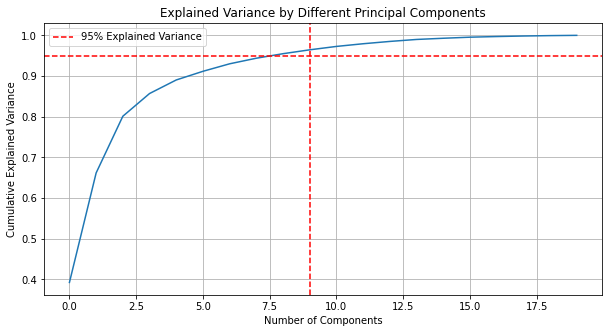

In [202]:
pca = PCA().fit(scaled_data)
# Plot the explained variance to determine the number of components to use
plt.figure(figsize=(10, 5))
plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.xlabel('Number of Components')
plt.ylabel('Cumulative Explained Variance')
plt.title('Explained Variance by Different Principal Components')
plt.grid(True)
plt.axhline(y=0.95, color='r', linestyle='--', label='95% Explained Variance')
plt.axvline(x=np.argmax(np.cumsum(pca.explained_variance_ratio_) >= 0.95) + 1, color='r', linestyle='--')
plt.legend(loc='best')
plt.show()


In [203]:
video_label = combined_df['label']
video_label 

0      biphasic_stim(Batch1)
1      biphasic_stim(Batch1)
2      biphasic_stim(Batch1)
3      biphasic_stim(Batch1)
4      biphasic_stim(Batch1)
               ...          
715    biphasic_stim(Batch3)
716    biphasic_stim(Batch3)
717    biphasic_stim(Batch3)
718    biphasic_stim(Batch3)
719    biphasic_stim(Batch3)
Name: label, Length: 14656, dtype: object

In [204]:
# Apply PCA
pca = PCA(n_components=10)
principal_components = pca.fit_transform(scaled_data)
principal_df = pd.DataFrame(data=principal_components, 
                            columns=['PC1', 'PC2', 'PC3', 'PC4', 'PC5', 'PC6', 'PC7', 'PC8', 'PC9', 'PC10'])

principal_df_PC1 = principal_df['PC1'].to_frame()
principal_df_PC2 = principal_df['PC2'].to_frame()
principal_df_PC3 = principal_df['PC3'].to_frame()
principal_df_PC4 = principal_df['PC4'].to_frame()
principal_df_PC5 = principal_df['PC5'].to_frame()
principal_df_PC6 = principal_df['PC6'].to_frame()
principal_df_PC7 = principal_df['PC7'].to_frame()
principal_df_PC8 = principal_df['PC8'].to_frame()
principal_df_PC9 = principal_df['PC9'].to_frame()
principal_df_PC10 = principal_df['PC10'].to_frame()

principal_df = pd.concat([principal_df, video_label.reset_index(drop=True)], axis = 1)
principal_df


,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,label
0,-0.883825,-0.870559,0.943646,0.837775,-0.703794,-1.311019,-1.062921,-1.548734,-0.012329,-0.111073,biphasic_stim(Batch1)
1,-1.128395,-0.820076,0.677912,0.863842,-0.875541,-1.458559,-0.844098,-1.375841,-0.061793,0.037697,biphasic_stim(Batch1)
2,-1.175880,-0.851746,0.659513,0.867168,-0.851641,-1.424567,-0.872351,-1.370386,-0.033007,0.029135,biphasic_stim(Batch1)
3,-1.190263,-0.860245,0.656415,0.853036,-0.844433,-1.413859,-0.876317,-1.371397,-0.018157,0.033178,biphasic_stim(Batch1)
4,-1.091841,-0.904289,0.783935,0.712136,-0.736721,-1.311831,-0.986304,-1.407200,-0.045600,0.076144,biphasic_stim(Batch1)
...,...,...,...,...,...,...,...,...,...,...,...
14651,-2.597578,1.224121,-0.481828,-1.290973,-0.898819,-0.890807,-0.814261,1.273091,-0.282451,0.898463,biphasic_stim(Batch3)
14652,-2.608576,1.221289,-0.497925,-1.291904,-0.906323,-0.893142,-0.813522,1.273735,-0.285241,0.902225,biphasic_stim(Batch3)
14653,-2.623071,1.130601,-0.582250,-1.230695,-0.879628,-0.895132,-0.826855,1.256718,-0.268690,0.952770,biphasic_stim(Batch3)
14654,-2.577017,1.197441,-0.539777,-1.216298,-0.901053,-0.885861,-0.834475,1.274136,-0.236486,0.954865,biphasic_stim(Batch3)


In [ ]:
# import matplotlib.pyplot as plt
# import seaborn as sns

# # Assuming 'principal_df' holds your PCA results and 'labels' are stored separately
# labels = combined_df['label']  # Make sure this grabs the correct label data aligned with your PCA data

# # Plotting the first two principal components
# plt.figure(figsize=(10, 8))
# sns.scatterplot(x=principal_df['PC1'], y=principal_df['PC2'], hue=labels, palette='viridis', s=100, alpha=0.7)
# plt.title('PCA: PC1 vs PC2 Colored by Label')
# plt.xlabel('Principal Component 1')
# plt.ylabel('Principal Component 2')
# plt.legend(title='Stimulation Type')
# plt.grid(True)
# plt.show()

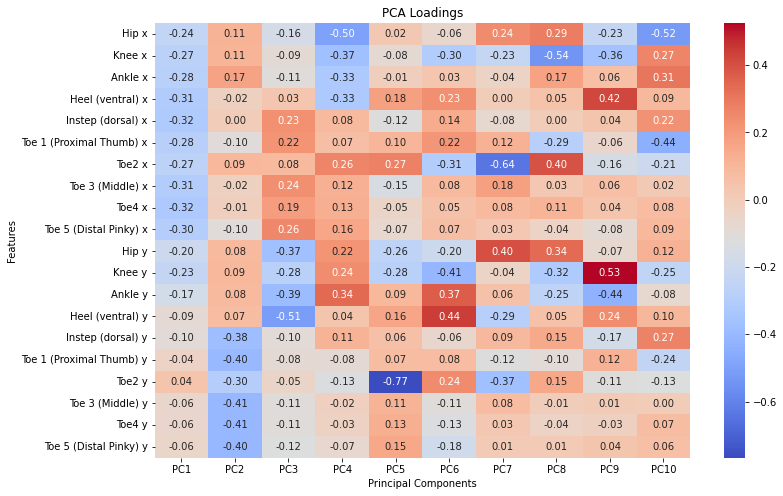

In [205]:
# Get the loadings
loadings = pca.components_.T

# Create a DataFrame for easier plotting
loading_matrix = pd.DataFrame(loadings, index=nonLabel_combined_df.columns, columns=[f'PC{i+1}' for i in range(loadings.shape[1])])

# Plotting the heatmap of loadings
plt.figure(figsize=(12, 8))
sns.heatmap(loading_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('PCA Loadings')
plt.xlabel('Principal Components')
plt.ylabel('Features')
plt.show()

The numbers in the PCA loadings matrix contains coefficients that represent how each original variable (different body parts and their coordinates) contributes to each principal component. These loadings help in interpreting the principal components by showing which variables are most influential for each component.

In [206]:
correlation_series_PC1 = calculate_pc_correlations(principal_df['PC1'], nonLabel_combined_df)
correlation_series_PC2 = calculate_pc_correlations(principal_df['PC2'], nonLabel_combined_df)
correlation_series_PC3 = calculate_pc_correlations(principal_df['PC3'], nonLabel_combined_df)
correlation_series_PC4 = calculate_pc_correlations(principal_df['PC4'], nonLabel_combined_df)
correlation_series_PC5 = calculate_pc_correlations(principal_df['PC5'], nonLabel_combined_df)
correlation_series_PC6 = calculate_pc_correlations(principal_df['PC6'], nonLabel_combined_df)
correlation_series_PC7 = calculate_pc_correlations(principal_df['PC7'], nonLabel_combined_df)
correlation_series_PC8 = calculate_pc_correlations(principal_df['PC8'], nonLabel_combined_df)
correlation_series_PC9 = calculate_pc_correlations(principal_df['PC9'], nonLabel_combined_df)
correlation_series_PC10 = calculate_pc_correlations(principal_df['PC10'], nonLabel_combined_df)

In [120]:
correlation_series_PC1

Hip x                      -0.672734
Knee x                     -0.750187
Ankle x                    -0.788991
Heel (ventral) x           -0.865008
Instep (dorsal) x          -0.885342
Toe 1 (Proximal Thumb) x   -0.798361
Toe2 x                     -0.743839
Toe 3 (Middle) x           -0.861839
Toe4 x                     -0.909254
Toe 5 (Distal Pinky) x     -0.829083
Hip y                      -0.569657
Knee y                     -0.652393
Ankle y                    -0.487758
Heel (ventral) y           -0.239879
Instep (dorsal) y          -0.282068
Toe 1 (Proximal Thumb) y   -0.100668
Toe2 y                      0.122529
Toe 3 (Middle) y           -0.172228
Toe4 y                     -0.167605
Toe 5 (Distal Pinky) y     -0.154966
dtype: float64

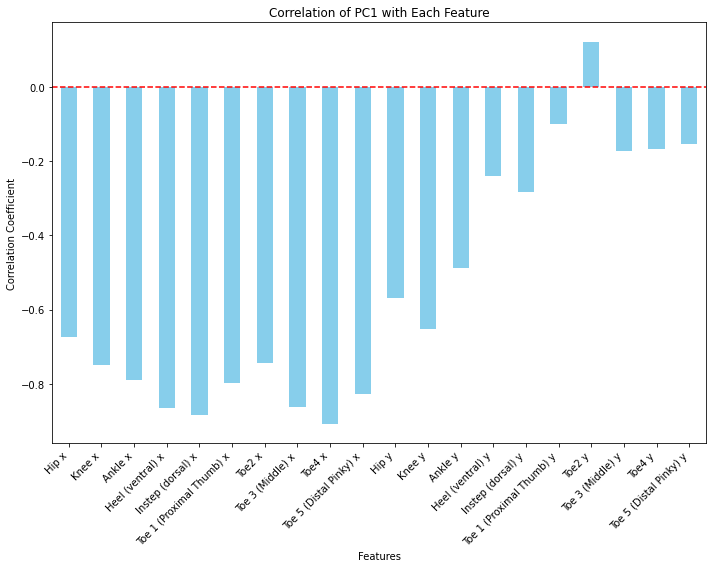

In [121]:
correlation_series_PC1 = calculate_pc_correlations(principal_df['PC1'], nonLabel_combined_df)

# Plotting
plt.figure(figsize=(10, 8))  # Set the figure size for better readability
correlation_series_PC1.plot(kind='bar', color='skyblue')  # Create a bar plot
plt.title('Correlation of PC1 with Each Feature')  # Title of the plot
plt.xlabel('Features')  # X-label which represents the features
plt.ylabel('Correlation Coefficient')  # Y-label which represents the correlation values
plt.axhline(0, color='red', linestyle='--')  # A line to show the zero correlation point
plt.xticks(rotation=45, ha='right')  # Rotate the x labels for better visibility
plt.tight_layout()  # Adjust subplots to give some padding
plt.show()  # Display the plot

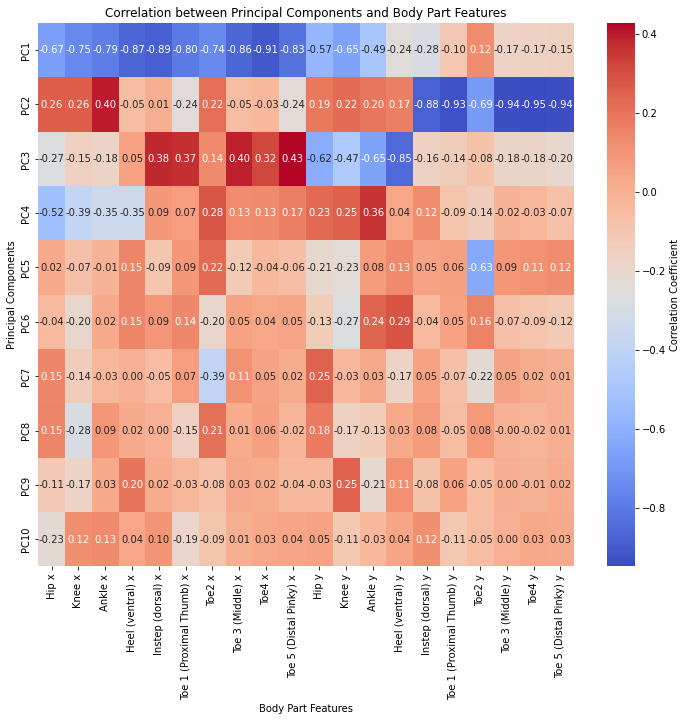

In [122]:
# Create an empty DataFrame to store correlation data
correlation_data = pd.DataFrame()
# Iterate over each principal component column in principal_df
for pc in principal_df.columns:
    pc_correlations = calculate_pc_correlations(principal_df[pc], nonLabel_combined_df)
    correlation_data[pc] = pc_correlations

# Transpose the DataFrame so that PCs are columns and features are rows
correlation_data = correlation_data.T

# Plotting the heatmap
plt.figure(figsize=(12, 10))
sns.heatmap(correlation_data, annot=True, cmap='coolwarm', fmt=".2f", cbar_kws={'label': 'Correlation Coefficient'})
plt.title('Correlation between Principal Components and Body Part Features')
plt.xlabel('Body Part Features')
plt.ylabel('Principal Components')
plt.show()

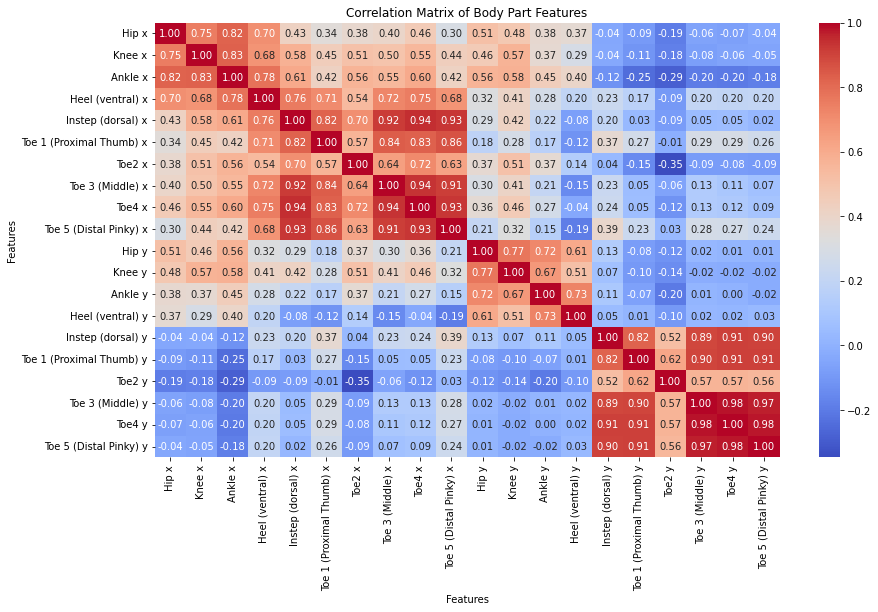

In [123]:
# Compute correlation matrix for the body part features
feature_correlation_matrix = nonLabel_combined_df.corr()

# Plotting the correlation matrix for body part features
plt.figure(figsize=(14, 8))
sns.heatmap(feature_correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Correlation Matrix of Body Part Features')
plt.xlabel('Features')
plt.ylabel('Features')
plt.show()

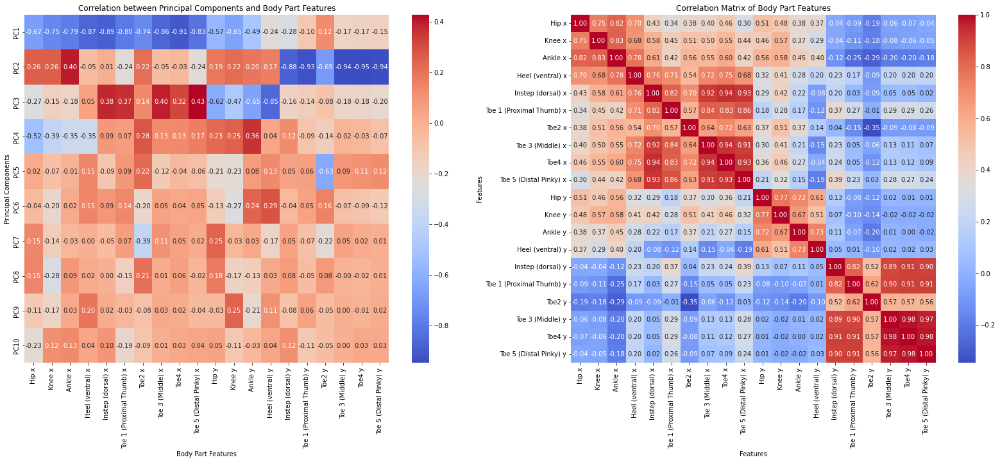

In [75]:
# Create a figure with subplots
fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(28, 10))

# Plot the first heatmap
sns.heatmap(correlation_data, ax=ax[0], annot=True, cmap='coolwarm', fmt=".2f")
ax[0].set_title('Correlation between Principal Components and Body Part Features')
ax[0].set_xlabel('Body Part Features')
ax[0].set_ylabel('Principal Components')

# Plot the second heatmap
sns.heatmap(feature_correlation_matrix, ax=ax[1], annot=True, cmap='coolwarm', fmt=".2f")
ax[1].set_title('Correlation Matrix of Body Part Features')
ax[1].set_xlabel('Features')
ax[1].set_ylabel('Features')

plt.show()

## Simple 3D visulization for the PC 

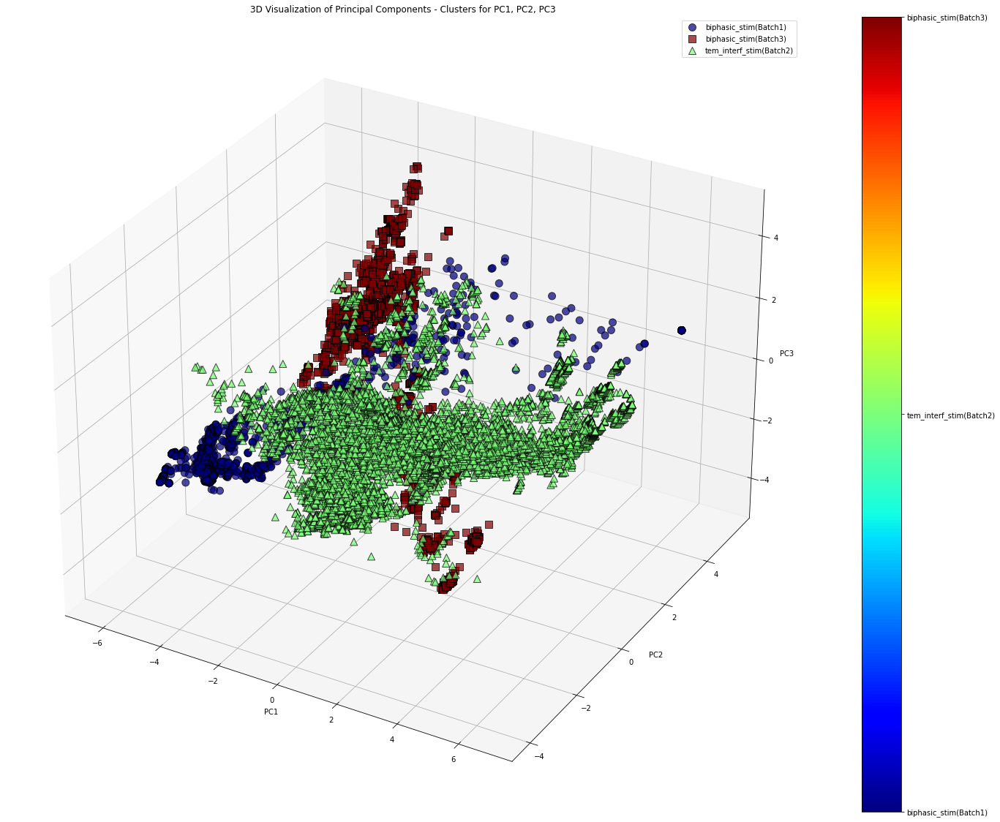

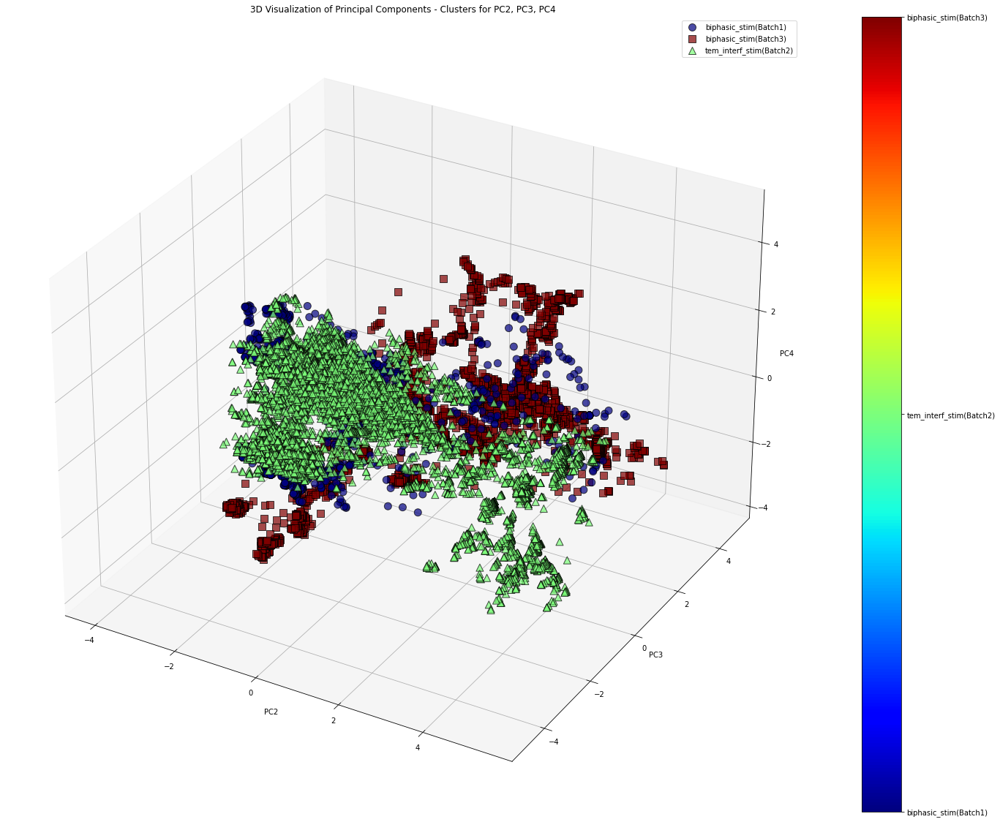

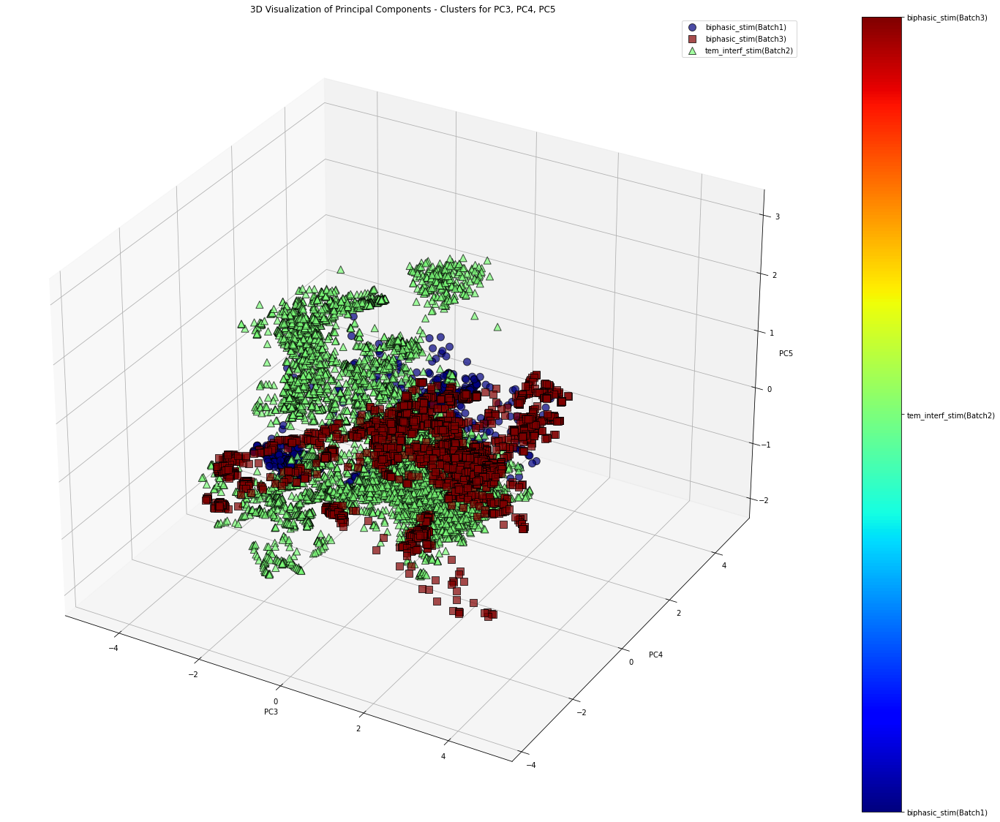

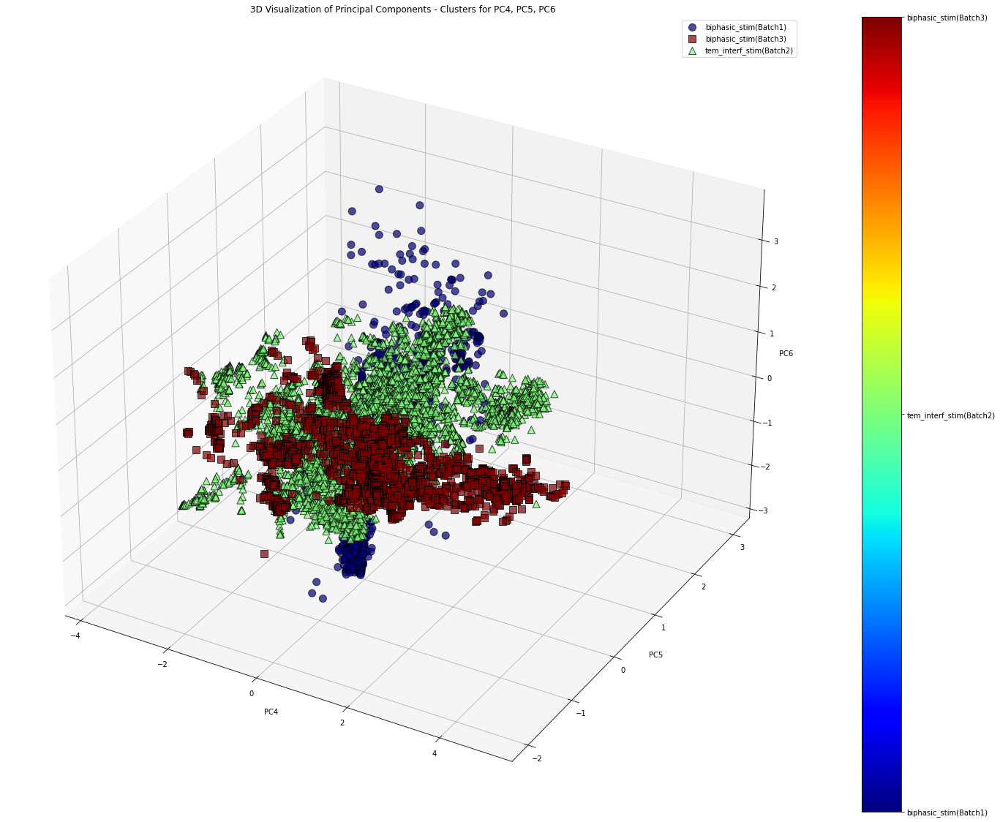

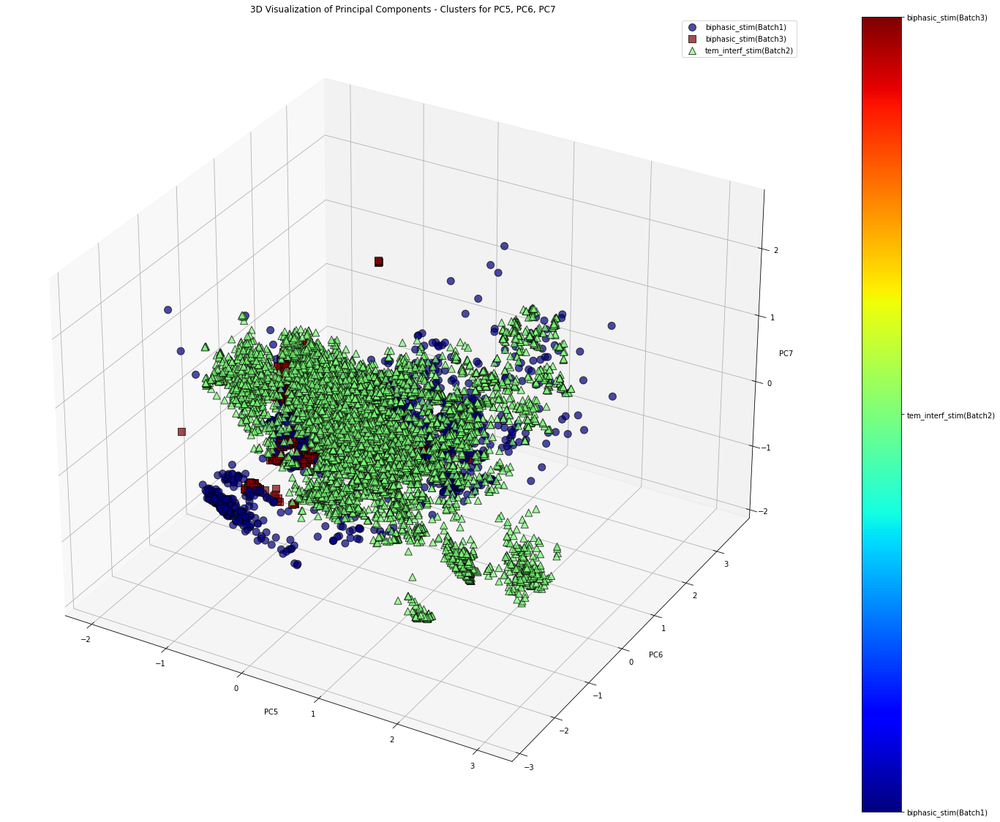

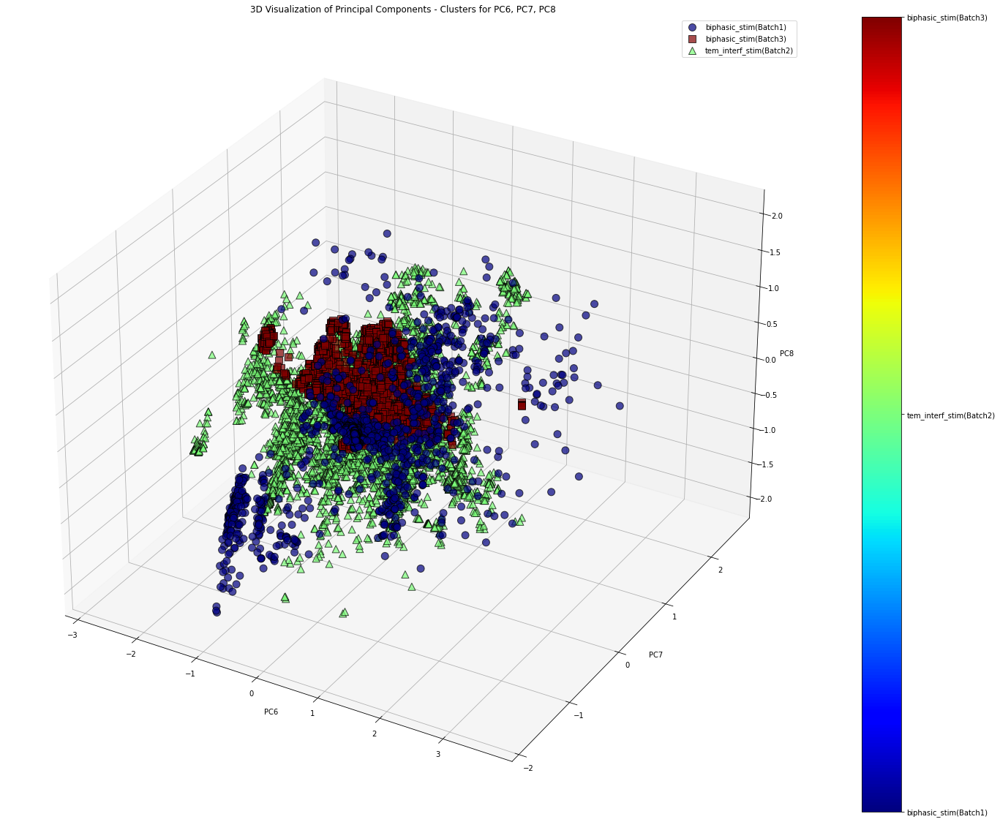

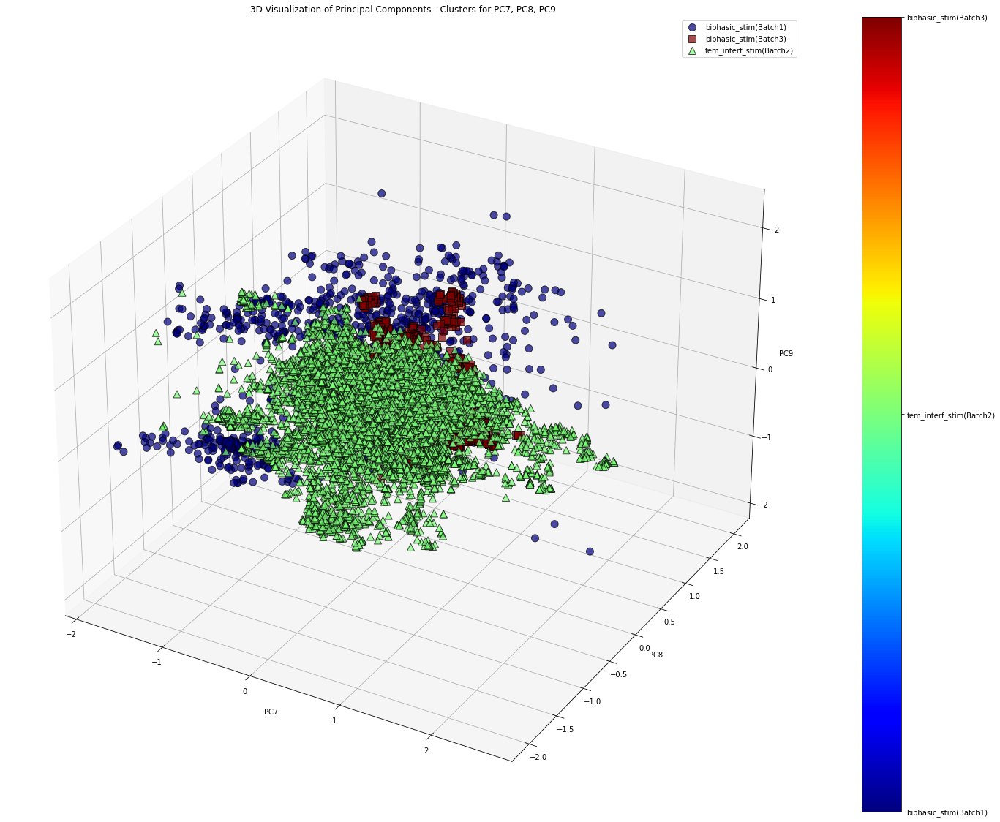

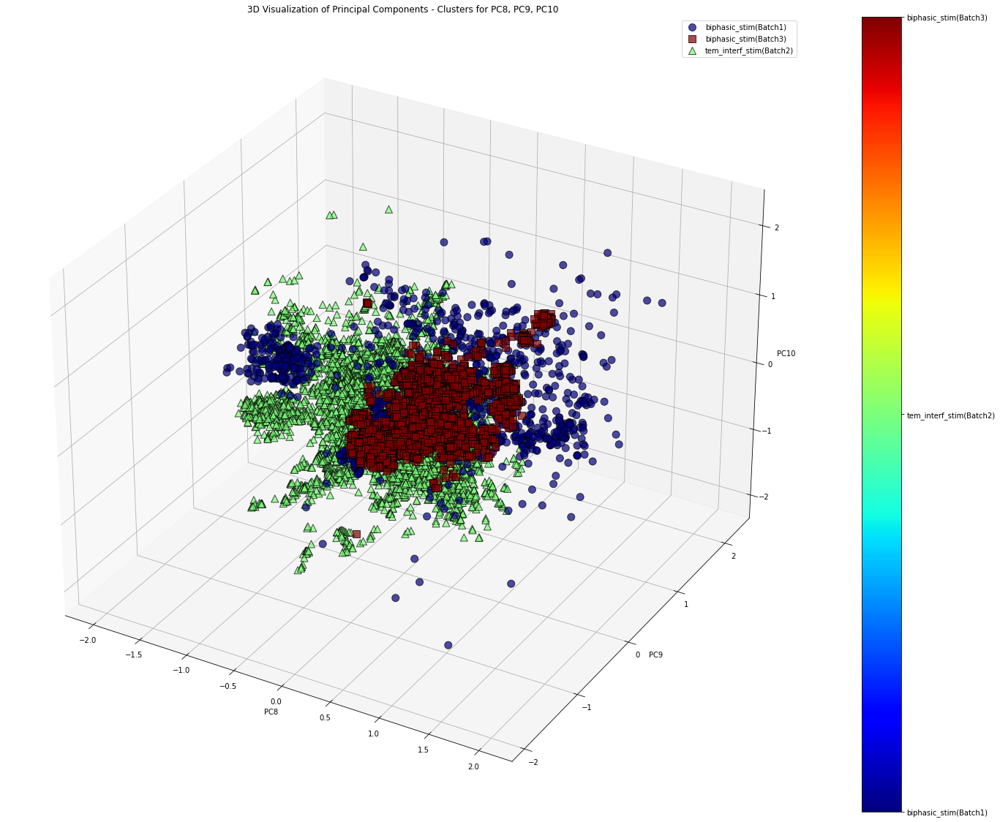

In [217]:
from mpl_toolkits.mplot3d import Axes3D


def plot_3d_clusters(data, title):
    # Generate all consecutive 3-PC combinations
    pc_combinations = [(f'PC{i}', f'PC{i+1}', f'PC{i+2}') for i in range(1, 9)]  

    for pc1, pc2, pc3 in pc_combinations:
        fig = plt.figure(figsize=(30, 20))
        ax = fig.add_subplot(111, projection='3d')
        x = data[pc1]
        y = data[pc2]
        z = data[pc3]

        # Define markers
        markers = {'biphasic_stim(Batch1)': 'o', 'biphasic_stim(Batch3)': 's', 'tem_interf_stim(Batch2)': '^'}

        # Map labels to colors and markers
        unique_labels = data['label'].unique()
        colors = plt.cm.jet(np.linspace(0, 1, len(unique_labels)))
        label_color_map = {label: color for label, color in zip(unique_labels, colors)}

        # Plot each label with its corresponding marker and color
        for label, marker in markers.items():
            subset = data[data['label'] == label]
            ax.scatter(subset[pc1], subset[pc2], subset[pc3], c=[label_color_map[label]], marker=marker, edgecolor='k', s=100, alpha=0.7, label=label)

        # Create colorbar as legend
        cmap = plt.cm.jet
        norm = plt.Normalize(vmin=0, vmax=len(unique_labels)-1)
        sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
        sm.set_array([])
        cbar = plt.colorbar(sm, ticks=np.linspace(0, len(unique_labels)-1, len(unique_labels)))
        cbar.set_ticklabels(unique_labels)

        # Setting labels, legend, and title
        ax.set_xlabel(pc1)
        ax.set_ylabel(pc2)
        ax.set_zlabel(pc3)
        ax.set_title(f'{title} - Clusters for {pc1}, {pc2}, {pc3}')
        plt.legend()
        plt.grid(True)

        # Save plot
        # Uncomment the next lines if you want to save the figures
        # figure_path = os.path.join(output_folder, f'3d_clusters_{pc1}_{pc2}_{pc3}.png')
        # plt.savefig(figure_path)
        plt.show()

# Example usage
plot_3d_clusters(principal_df, '3D Visualization of Principal Components')


Analyzing silhouette scores for PC1 vs PC2


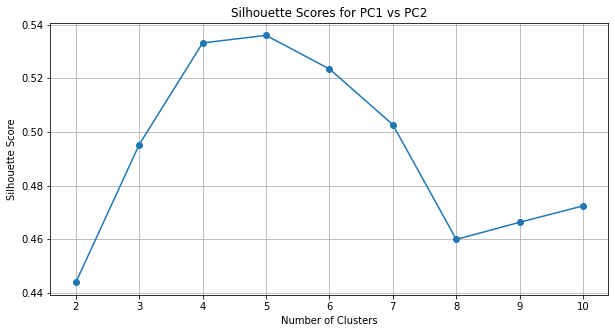

Analyzing silhouette scores for PC2 vs PC3


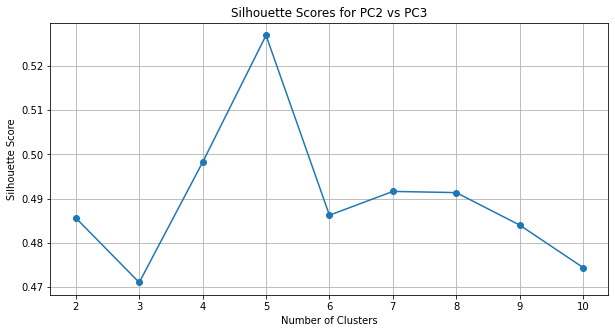

Analyzing silhouette scores for PC3 vs PC4


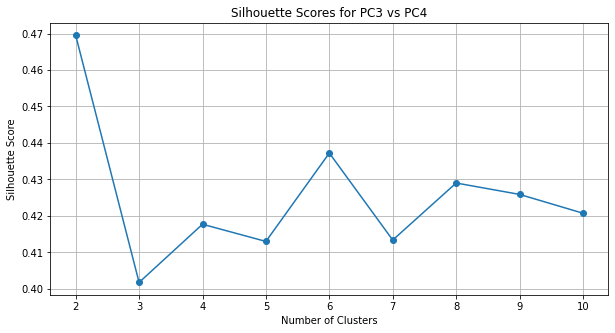

Analyzing silhouette scores for PC4 vs PC5


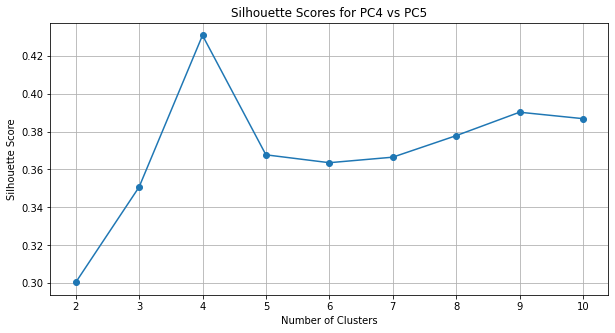

Analyzing silhouette scores for PC5 vs PC6


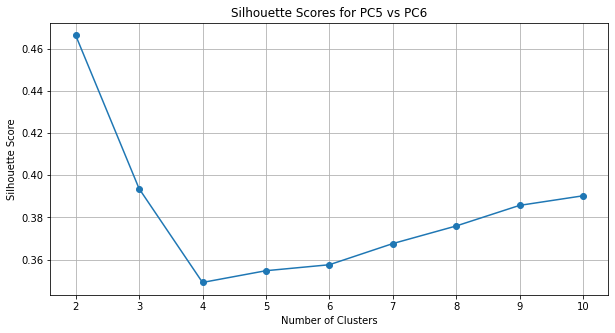

Analyzing silhouette scores for PC6 vs PC7


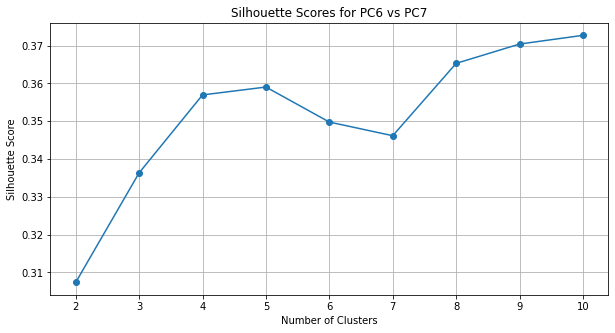

Analyzing silhouette scores for PC7 vs PC8


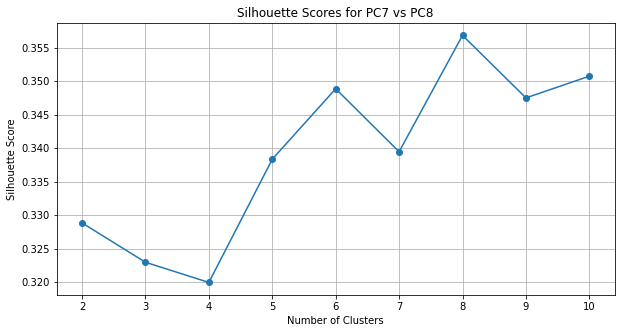

Analyzing silhouette scores for PC8 vs PC9


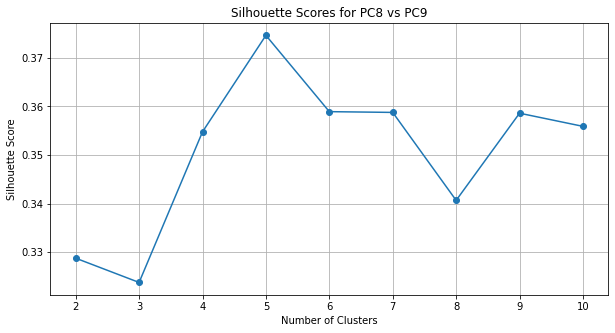

Analyzing silhouette scores for PC9 vs PC10


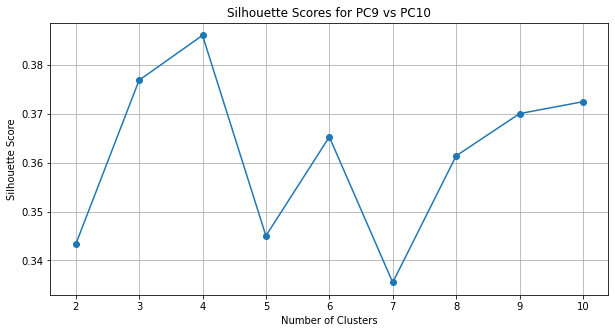

In [124]:
pc_combinations = [('PC1', 'PC2'), ('PC2', 'PC3'), ('PC3', 'PC4'), ('PC4', 'PC5'), ('PC5', 'PC6'), 
                   ('PC6', 'PC7'), ('PC7', 'PC8'), ('PC8', 'PC9'), ('PC9', 'PC10')]

# Analyze each combination
for pc1, pc2 in pc_combinations:
    print(f"Analyzing silhouette scores for {pc1} vs {pc2}")
    analyze_silhouette_scores(principal_df[[pc1, pc2]], f'{pc1} vs {pc2}')

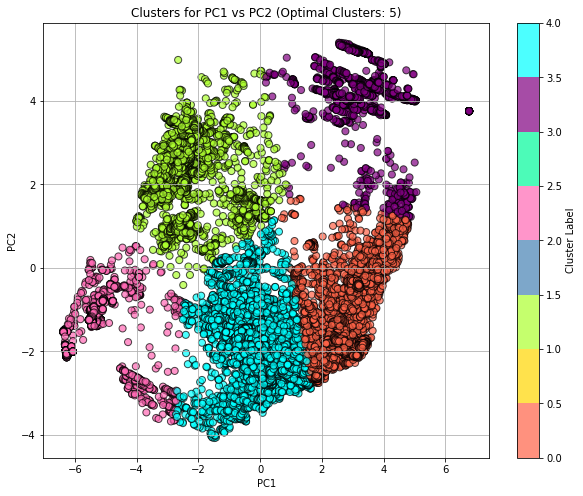

Optimal number of clusters for PC1 vs PC2: 5, with silhouette score: 0.54


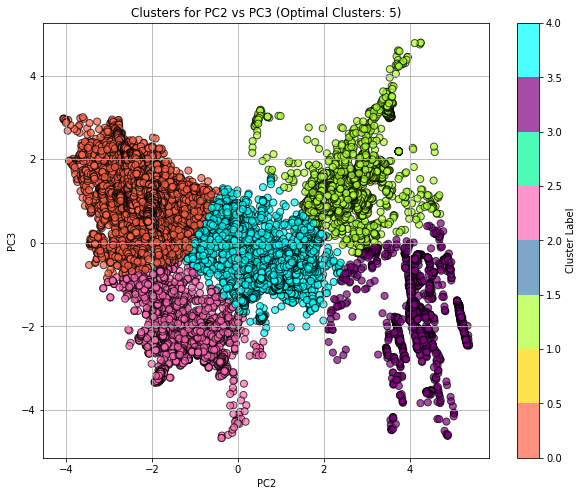

Optimal number of clusters for PC2 vs PC3: 5, with silhouette score: 0.53


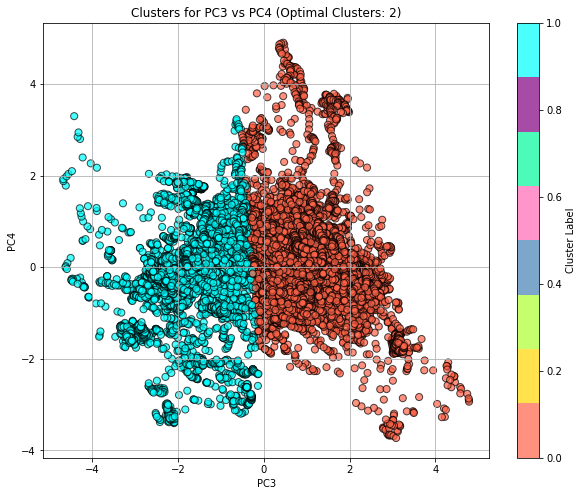

Optimal number of clusters for PC3 vs PC4: 2, with silhouette score: 0.47


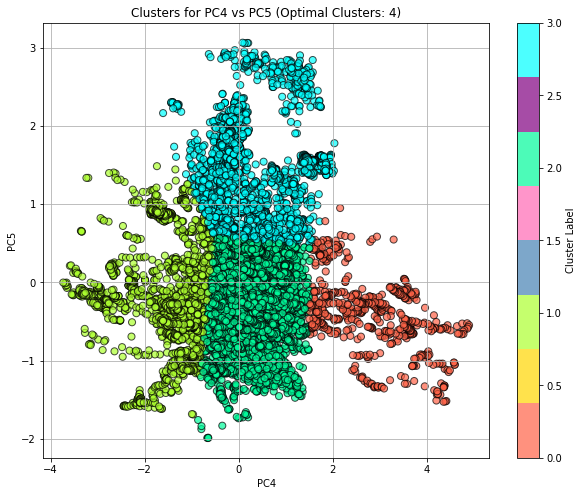

Optimal number of clusters for PC4 vs PC5: 4, with silhouette score: 0.43


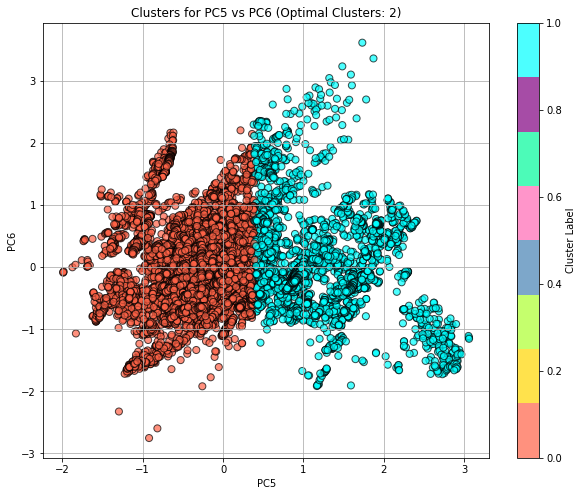

Optimal number of clusters for PC5 vs PC6: 2, with silhouette score: 0.47


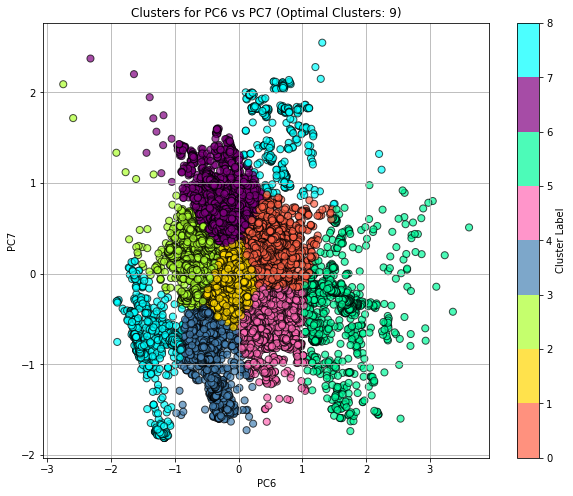

Optimal number of clusters for PC6 vs PC7: 9, with silhouette score: 0.37


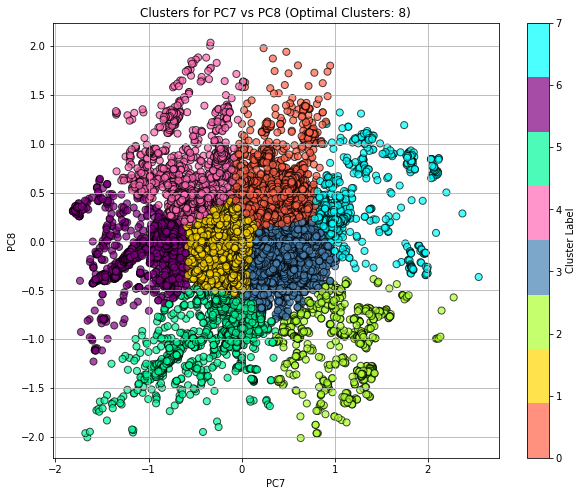

Optimal number of clusters for PC7 vs PC8: 8, with silhouette score: 0.36


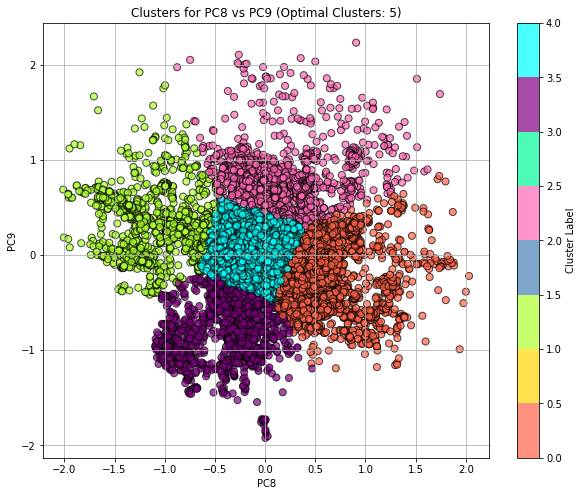

Optimal number of clusters for PC8 vs PC9: 5, with silhouette score: 0.38


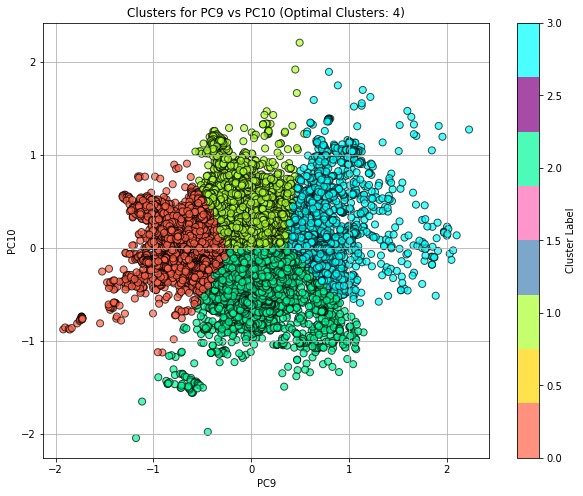

Optimal number of clusters for PC9 vs PC10: 4, with silhouette score: 0.39


In [43]:
output_folder = '/Users/shawnyang/Desktop/UofT/ECE2500Y/ece2500Y/Analysis/Cluster'
os.makedirs(output_folder, exist_ok=True)  # Create the directory if it does not exist

# Define principal component combinations
pc_combinations = [('PC1', 'PC2'), ('PC2', 'PC3'), ('PC3', 'PC4'), ('PC4', 'PC5'), 
                   ('PC5', 'PC6'), ('PC6', 'PC7'), ('PC7', 'PC8'), ('PC8', 'PC9'), ('PC9', 'PC10')]

# Analyze and plot clusters for each combination
for pc1, pc2 in pc_combinations:
    data = principal_df[[pc1, pc2]]
    title = f"{pc1} vs {pc2}"
    
    range_n_clusters = list(range(2, 11))  # Cluster range from 2 to 10
    silhouette_avg_scores = []

    for n_clusters in range_n_clusters:
        kmeans = KMeans(n_clusters=n_clusters, random_state=10)
        cluster_labels = kmeans.fit_predict(data)
        silhouette_avg = silhouette_score(data, cluster_labels)
        silhouette_avg_scores.append(silhouette_avg)

    optimal_clusters = range_n_clusters[np.argmax(silhouette_avg_scores)]
    kmeans = KMeans(n_clusters=optimal_clusters, random_state=10)
    cluster_labels = kmeans.fit_predict(data)

    cmap = ListedColormap(['#FF6347', '#FFD700', '#ADFF2F', '#4682B4', '#FF69B4', '#00FA9A', '#800080', '#00FFFF'])

    # Plotting the results
    plt.figure(figsize=(10, 8))
    plt.scatter(data.iloc[:, 0], data.iloc[:, 1], c=cluster_labels, cmap=cmap, marker='o', edgecolor='k', s=50, alpha=0.7)
    plt.title(f'Clusters for {title} (Optimal Clusters: {optimal_clusters})')
    plt.xlabel(data.columns[0])
    plt.ylabel(data.columns[1])
    plt.colorbar(label='Cluster Label')
    plt.grid(True)
    plt.show()

    # Save the figure
    figure_path = os.path.join(output_folder, f'clusters_{pc1}_{pc2}.png')
    plt.savefig(figure_path)
    plt.close()

    print(f"Optimal number of clusters for {title}: {optimal_clusters}, with silhouette score: {max(silhouette_avg_scores):.2f}")

## Seperate the data based on frequency

In [138]:
# Filter out the Biphasic Stimulation dataframes (Batch 1 and 3)
bis_df = combined_df[combined_df['label'].str.contains('Batch1|Batch3')]

# Filter out the Temporal Interference Stimulation dataframes (Batch 2 and 4)
tis_df = combined_df[combined_df['label'].str.contains('Batch2')]

print("BIS Data Count:", bis_df.shape[0])
print("TIS Data Count:", tis_df.shape[0])


BIS Data Count: 5525
TIS Data Count: 9131


In [149]:
def apply_pca(data, n_components=10):
    data_for_pca = data.select_dtypes(include=[np.number])  # Select only numerical columns for PCA
    scaler = StandardScaler()
    scaled_data = scaler.fit_transform(data_for_pca)
    pca = PCA(n_components=n_components)
    principal_components = pca.fit_transform(scaled_data)
    principal_df = pd.DataFrame(principal_components, columns=[f'PC{i+1}' for i in range(n_components)])
    principal_df['label'] = data['label'].values  
    return principal_df

# Apply PCA on BIS data
bis_principal_df = apply_pca(bis_df)

# Apply PCA on TIS data
tis_principal_df = apply_pca(tis_df)
bis_principal_df

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,label
0,0.915684,1.288018,1.177655,1.055101,-2.954588,0.620011,0.043094,-0.514692,-0.411581,0.036370,biphasic_stim(Batch1)
1,0.662898,1.328195,1.193802,0.684074,-2.930894,0.362341,0.337891,-0.213825,-0.288500,0.121061,biphasic_stim(Batch1)
2,0.598064,1.326489,1.198452,0.721962,-2.909891,0.380301,0.335739,-0.186927,-0.290753,0.133785,biphasic_stim(Batch1)
3,0.581790,1.327664,1.182214,0.734076,-2.901286,0.386162,0.342620,-0.185791,-0.278857,0.151891,biphasic_stim(Batch1)
4,0.684983,1.326375,1.025649,0.935381,-2.885814,0.378402,0.262745,-0.298653,-0.313719,0.101725,biphasic_stim(Batch1)
...,...,...,...,...,...,...,...,...,...,...,...
5520,-0.345479,0.250483,-1.586006,-0.969935,0.075538,-1.388248,-1.725549,-0.770750,-0.681241,0.169932,biphasic_stim(Batch3)
5521,-0.360946,0.257444,-1.585223,-0.982824,0.072780,-1.392930,-1.712168,-0.758574,-0.686750,0.174199,biphasic_stim(Batch3)
5522,-0.439042,0.349569,-1.529379,-0.968505,0.069345,-1.400467,-1.722859,-0.797378,-0.629886,0.170872,biphasic_stim(Batch3)
5523,-0.360070,0.312898,-1.510282,-0.982030,0.083962,-1.427617,-1.715186,-0.788763,-0.657551,0.226090,biphasic_stim(Batch3)


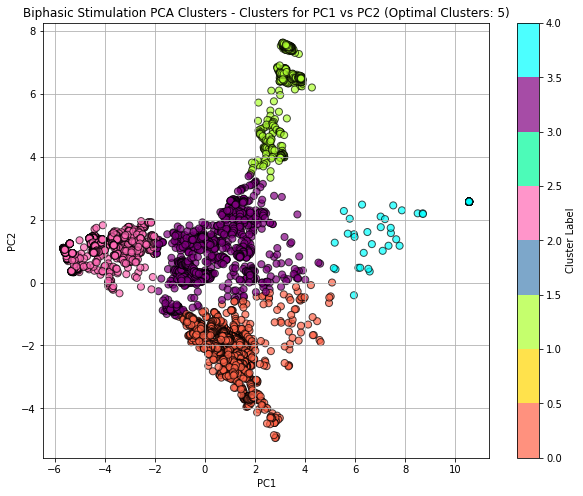

Optimal number of clusters for PC1 vs PC2: 5, with silhouette score: 0.60


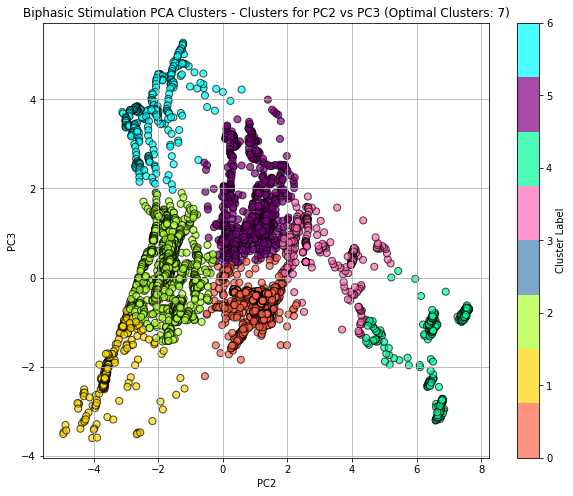

Optimal number of clusters for PC2 vs PC3: 7, with silhouette score: 0.61


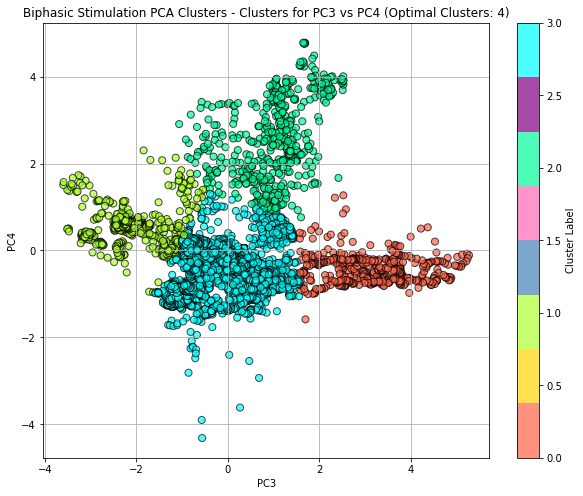

Optimal number of clusters for PC3 vs PC4: 4, with silhouette score: 0.53


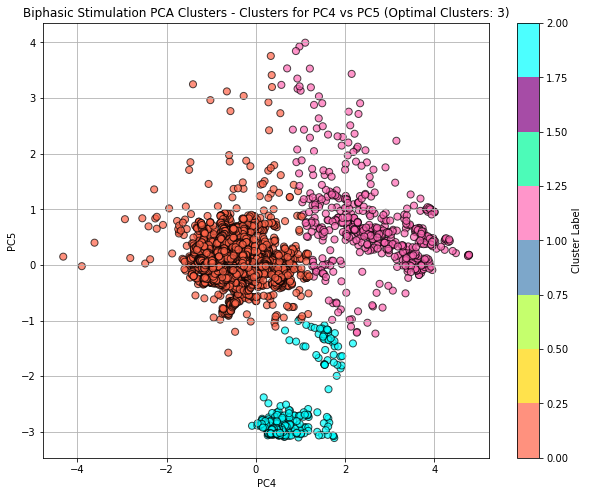

Optimal number of clusters for PC4 vs PC5: 3, with silhouette score: 0.70


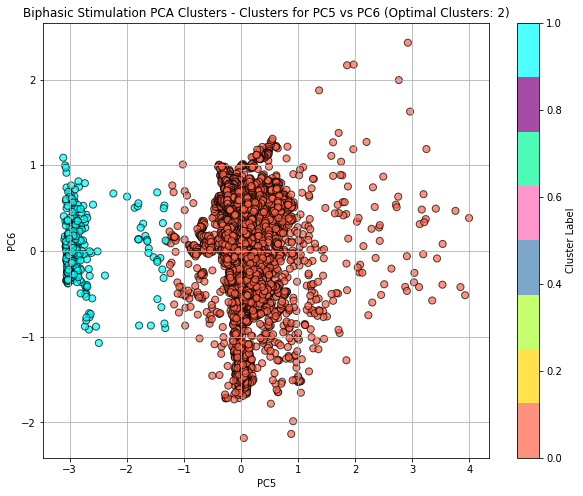

Optimal number of clusters for PC5 vs PC6: 2, with silhouette score: 0.70


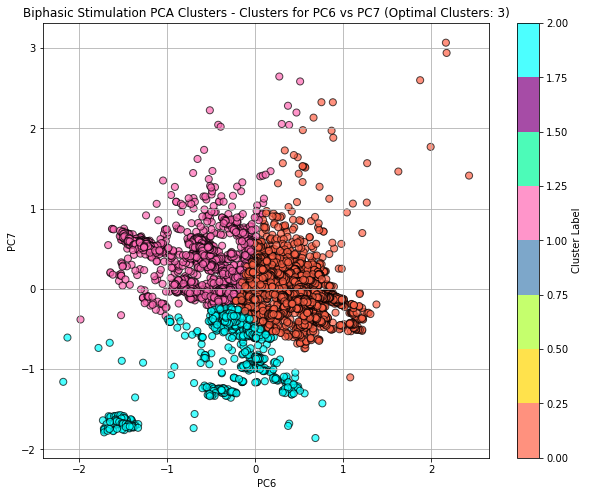

Optimal number of clusters for PC6 vs PC7: 3, with silhouette score: 0.46


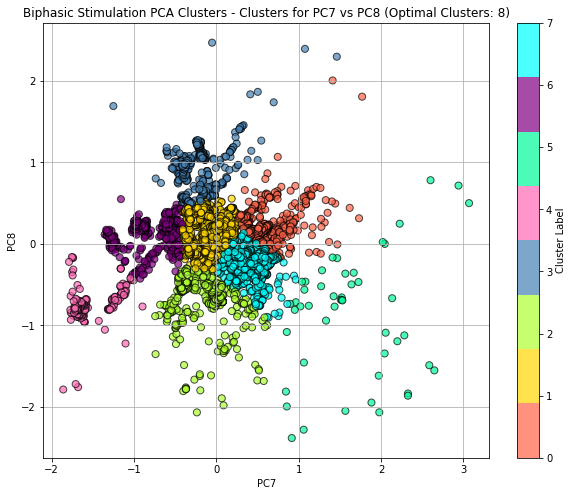

Optimal number of clusters for PC7 vs PC8: 8, with silhouette score: 0.47


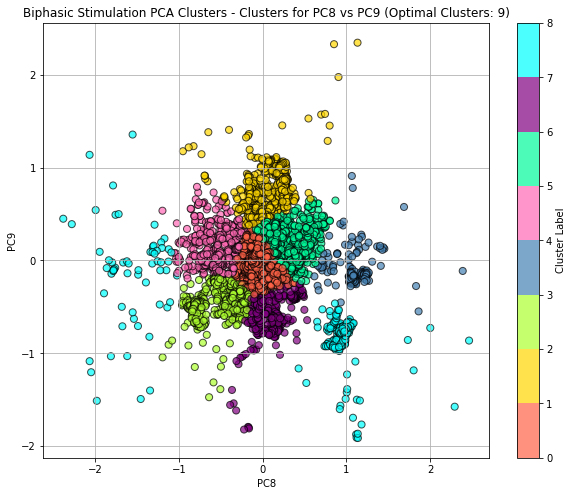

Optimal number of clusters for PC8 vs PC9: 9, with silhouette score: 0.41


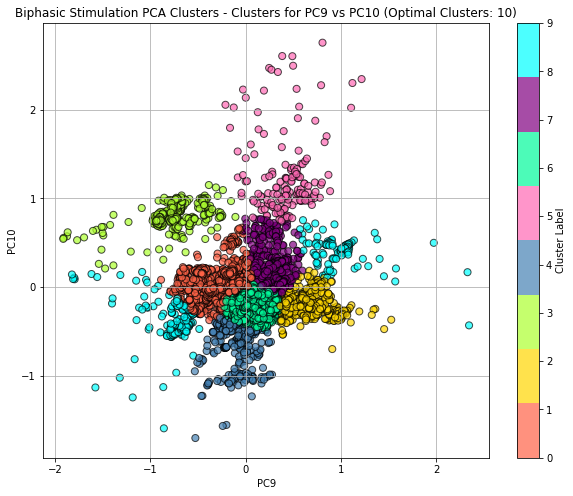

Optimal number of clusters for PC9 vs PC10: 10, with silhouette score: 0.41


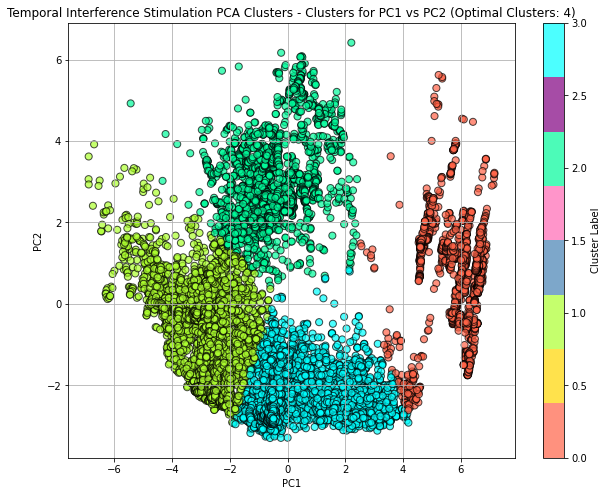

Optimal number of clusters for PC1 vs PC2: 4, with silhouette score: 0.52


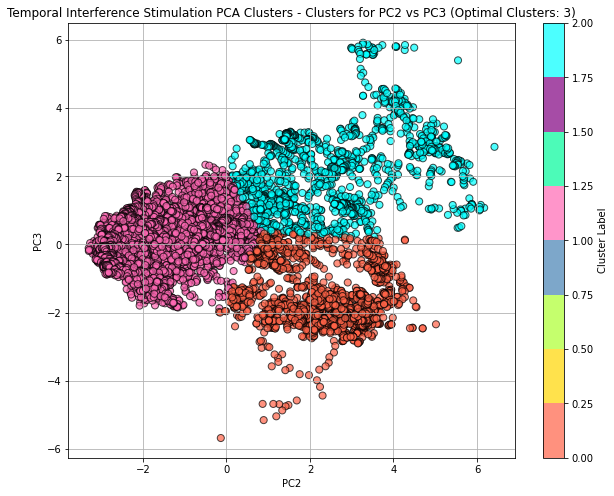

Optimal number of clusters for PC2 vs PC3: 3, with silhouette score: 0.55


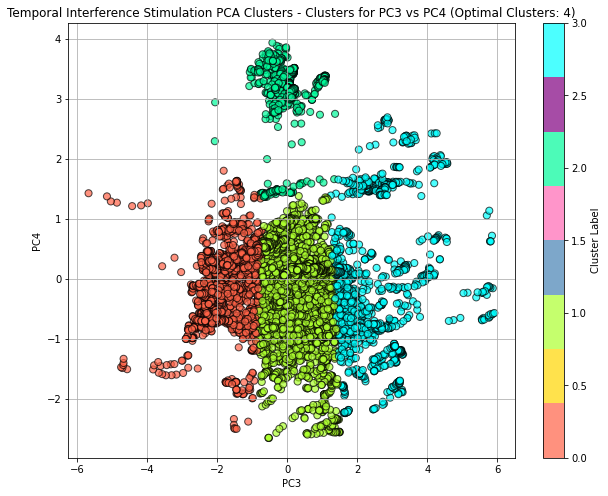

Optimal number of clusters for PC3 vs PC4: 4, with silhouette score: 0.45


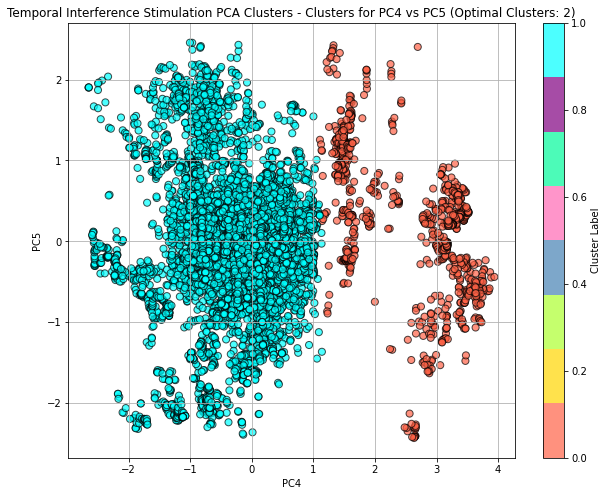

Optimal number of clusters for PC4 vs PC5: 2, with silhouette score: 0.59


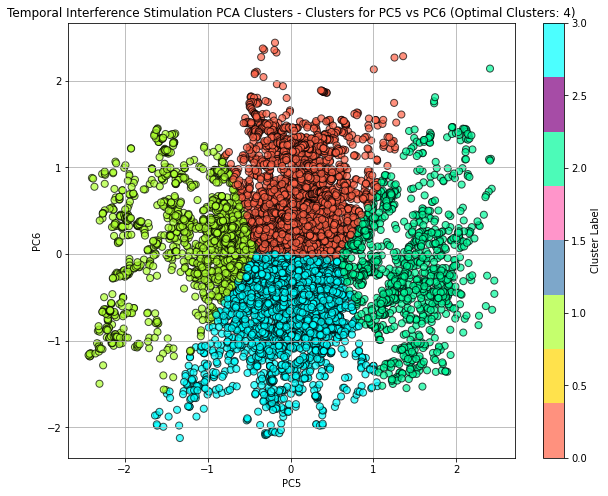

Optimal number of clusters for PC5 vs PC6: 4, with silhouette score: 0.37


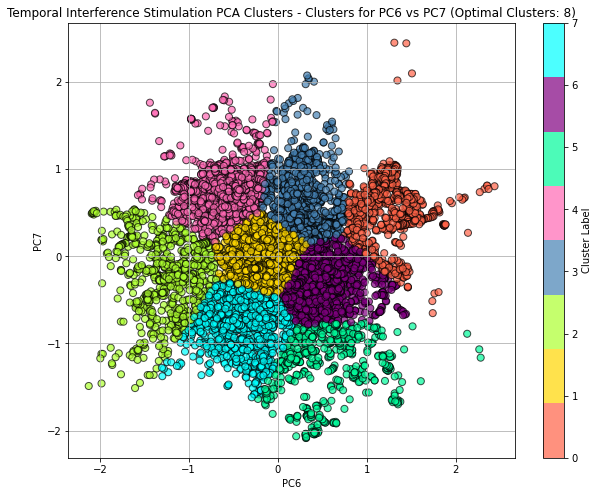

Optimal number of clusters for PC6 vs PC7: 8, with silhouette score: 0.37


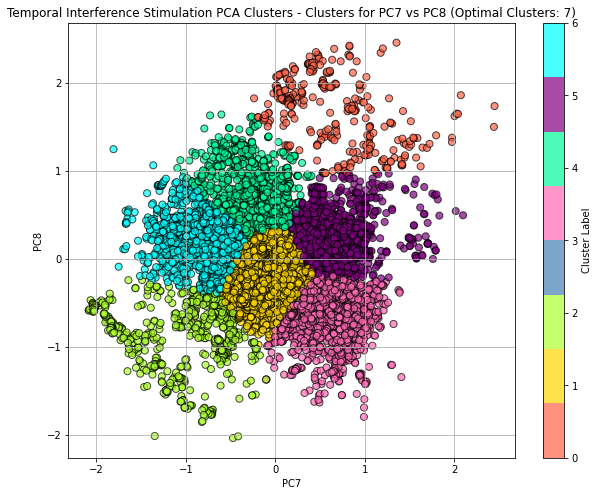

Optimal number of clusters for PC7 vs PC8: 7, with silhouette score: 0.37


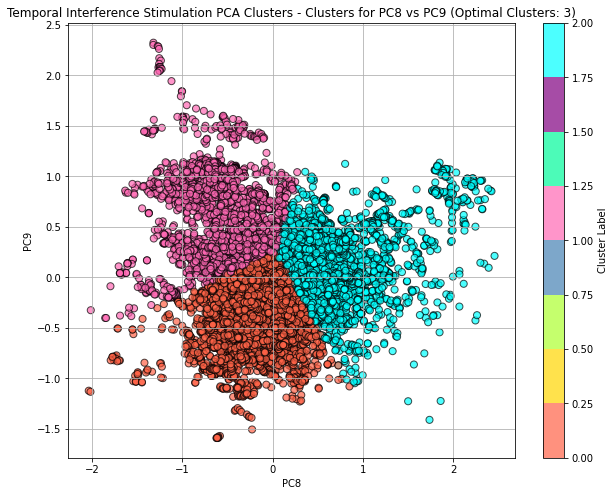

Optimal number of clusters for PC8 vs PC9: 3, with silhouette score: 0.36


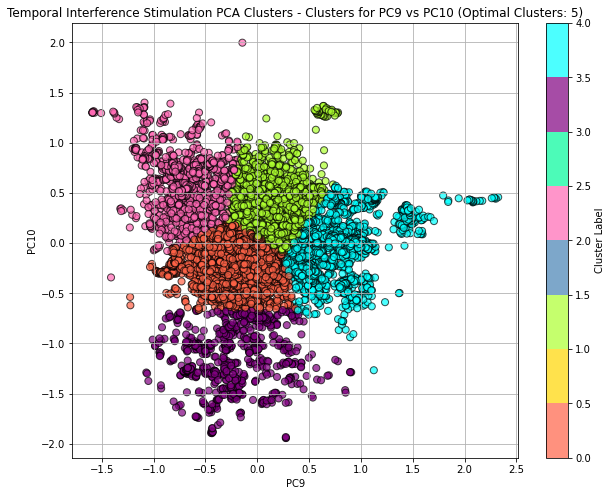

Optimal number of clusters for PC9 vs PC10: 5, with silhouette score: 0.39


In [134]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

def plot_clusters(data, title, output_folder):
    pc_combinations = [('PC1', 'PC2'), ('PC2', 'PC3'), ('PC3', 'PC4'), ('PC4', 'PC5'), 
                       ('PC5', 'PC6'), ('PC6', 'PC7'), ('PC7', 'PC8'), ('PC8', 'PC9'), ('PC9', 'PC10')]
    os.makedirs(output_folder, exist_ok=True)  # Ensure the directory exists

    for pc1, pc2 in pc_combinations:
        pca_data = data[[pc1, pc2]]
        range_n_clusters = list(range(2, 11))
        silhouette_avg_scores = []

        for n_clusters in range_n_clusters:
            kmeans = KMeans(n_clusters=n_clusters, random_state=10)
            cluster_labels = kmeans.fit_predict(pca_data)
            silhouette_avg = silhouette_score(pca_data, cluster_labels)
            silhouette_avg_scores.append(silhouette_avg)

        optimal_clusters = range_n_clusters[np.argmax(silhouette_avg_scores)]
        kmeans = KMeans(n_clusters=optimal_clusters, random_state=10)
        cluster_labels = kmeans.fit_predict(pca_data)

        cmap = ListedColormap(['#FF6347', '#FFD700', '#ADFF2F', '#4682B4', '#FF69B4', '#00FA9A', '#800080', '#00FFFF'])

        plt.figure(figsize=(10, 8))
        plt.scatter(pca_data.iloc[:, 0], pca_data.iloc[:, 1], c=cluster_labels, cmap=cmap, marker='o', edgecolor='k', s=50, alpha=0.7)
        plt.title(f'{title} - Clusters for {pc1} vs {pc2} (Optimal Clusters: {optimal_clusters})')
        plt.xlabel(pc1)
        plt.ylabel(pc2)
        plt.colorbar(label='Cluster Label')
        plt.grid(True)
        plt.show()

        figure_path = os.path.join(output_folder, f'clusters_{pc1}_{pc2}.png')
        plt.savefig(figure_path)
        plt.close()

        print(f"Optimal number of clusters for {pc1} vs {pc2}: {optimal_clusters}, with silhouette score: {max(silhouette_avg_scores):.2f}")


output_folder_bis = '/Users/shawnyang/Desktop/UofT/ECE2500Y/ece2500Y/Analysis/Cluster/seperate_fre/bis_sti'
output_folder_tis = '/Users/shawnyang/Desktop/UofT/ECE2500Y/ece2500Y/Analysis/Cluster/seperate_fre/bis_sti'

plot_clusters(bis_principal_df, 'Biphasic Stimulation PCA Clusters', output_folder_bis)
plot_clusters(tis_principal_df, 'Temporal Interference Stimulation PCA Clusters', output_folder_tis)


## DBSCAN

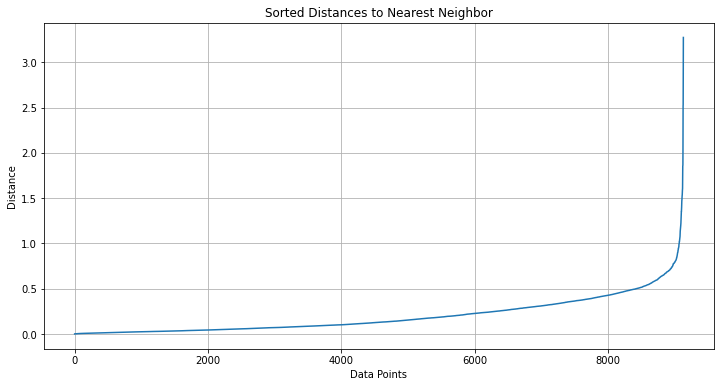

In [173]:
from sklearn.neighbors import NearestNeighbors

def plot_nearest_neighbors(data, n_neighbors=5):
    neighbors = NearestNeighbors(n_neighbors=n_neighbors)
    neighbors_fit = neighbors.fit(data)
    distances, indices = neighbors_fit.kneighbors(data)

    # Sort the distances
    sorted_distances = np.sort(distances, axis=0)
    distances_dec = sorted_distances[:, 1] 
    plt.figure(figsize=(12, 6))
    plt.plot(distances_dec)
    plt.title('Sorted Distances to Nearest Neighbor')
    plt.xlabel('Data Points')
    plt.ylabel('Distance')
    plt.grid(True)
    plt.show()

# Assuming bis_principal_df is already defined and PCA applied
# plot_nearest_neighbors(bis_principal_df.iloc[:, :10],n_neighbors=5)
plot_nearest_neighbors(tis_principal_df.iloc[:, :10],n_neighbors=5)


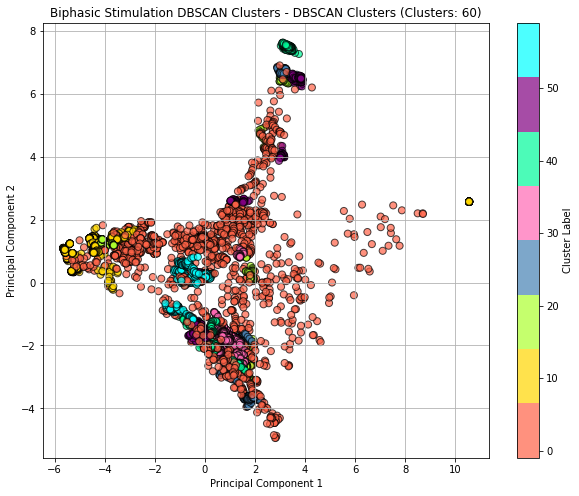

DBSCAN: 60 clusters, silhouette score: 0.31


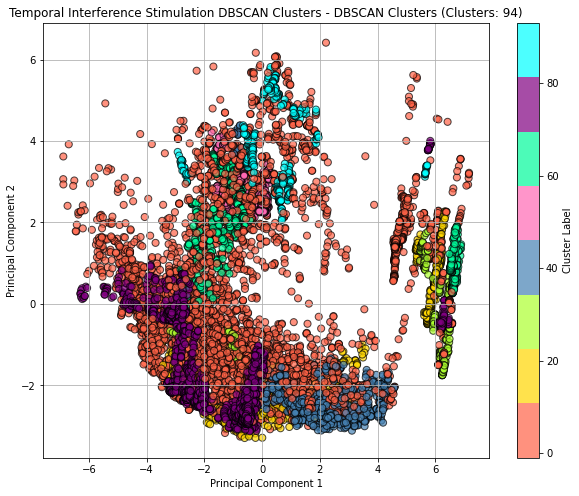

DBSCAN: 94 clusters, silhouette score: -0.05


In [187]:
from sklearn.cluster import DBSCAN
import os

def plot_dbscan_clusters(data, title, eps, min_samples):
    # Ensure the directory exists
    # os.makedirs(output_folder, exist_ok=True)

    # Apply DBSCAN to the entire dataset
    dbscan = DBSCAN(eps=eps, min_samples=min_samples)
    cluster_labels = dbscan.fit_predict(data)

    # Check the number of clusters formed, minus one for noise if present
    n_clusters_ = len(set(cluster_labels)) - (1 if -1 in cluster_labels else 0)
    
    # Compute silhouette score only if more than 1 cluster and less than len(data)
    silhouette_avg = silhouette_score(data, cluster_labels) if 1 < n_clusters_ < len(data) else -1

    cmap = ListedColormap(['#FF6347', '#FFD700', '#ADFF2F', '#4682B4', '#FF69B4', '#00FA9A', '#800080', '#00FFFF'])
    
    plt.figure(figsize=(10, 8))
    scatter = plt.scatter(data.iloc[:, 0], data.iloc[:, 1], c=cluster_labels, cmap=cmap, marker='o', edgecolor='k', s=50, alpha=0.7)
    plt.title(f'{title} - DBSCAN Clusters (Clusters: {n_clusters_})')
    plt.xlabel('Principal Component 1')
    plt.ylabel('Principal Component 2')
    plt.colorbar(scatter, label='Cluster Label')
    plt.grid(True)
    plt.show()

    # figure_path = os.path.join(output_folder, 'dbscan_clusters.png')
    # plt.savefig(figure_path)
    # plt.close()

    print(f"DBSCAN: {n_clusters_} clusters, silhouette score: {silhouette_avg:.2f}")

# Usage
# output_folder_bis = '/Users/shawnyang/Desktop/UofT/ECE2500Y/ece2500Y/Analysis/Cluster/seperate_fre/bis_sti'
# output_folder_tis = '/Users/shawnyang/Desktop/UofT/ECE2500Y/ece2500Y/Analysis/Cluster/seperate_fre/tis_sti'

plot_dbscan_clusters(bis_principal_df.iloc[:, :10], 'Biphasic Stimulation DBSCAN Clusters', eps=0.4, min_samples=11)
plot_dbscan_clusters(tis_principal_df.iloc[:, :10], 'Temporal Interference Stimulation DBSCAN Clusters', eps=0.5, min_samples=11)


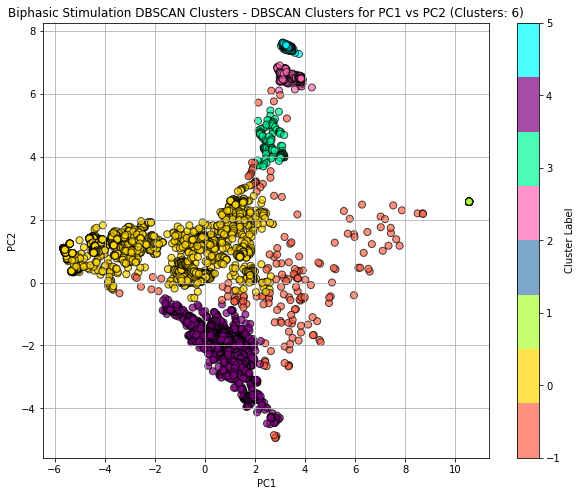

DBSCAN for PC1 vs PC2: 6 clusters, silhouette score: 0.47


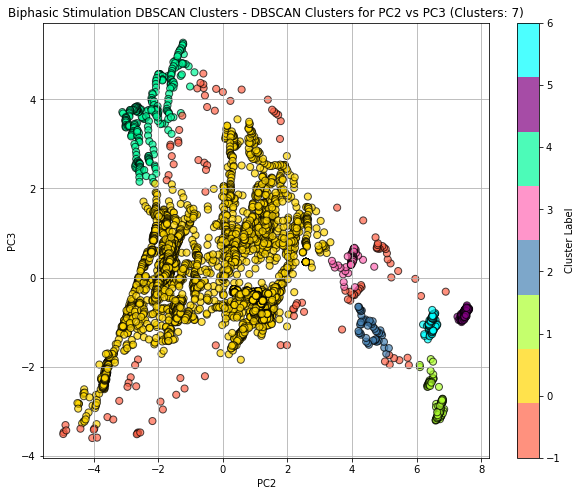

DBSCAN for PC2 vs PC3: 7 clusters, silhouette score: 0.27


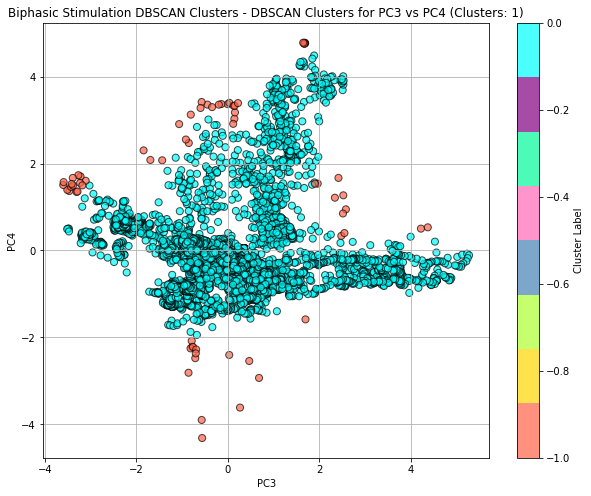

DBSCAN for PC3 vs PC4: 1 clusters, silhouette score: -1.00


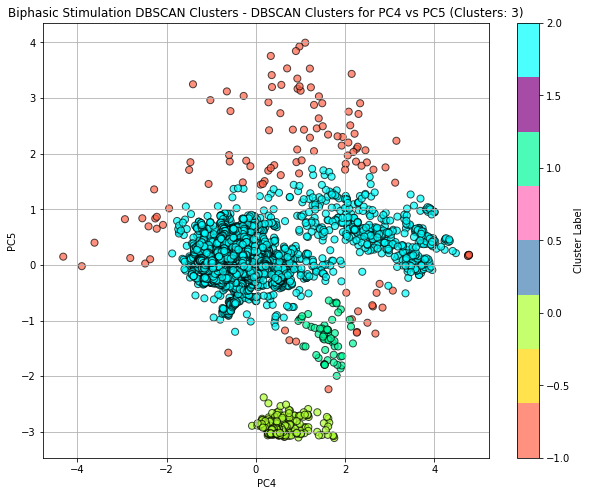

DBSCAN for PC4 vs PC5: 3 clusters, silhouette score: 0.52


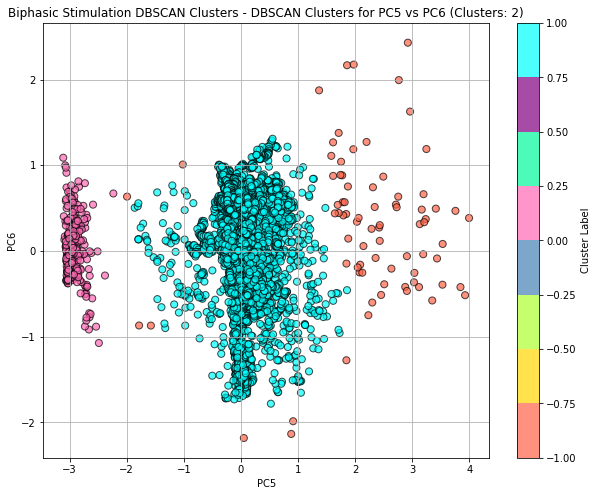

DBSCAN for PC5 vs PC6: 2 clusters, silhouette score: 0.65


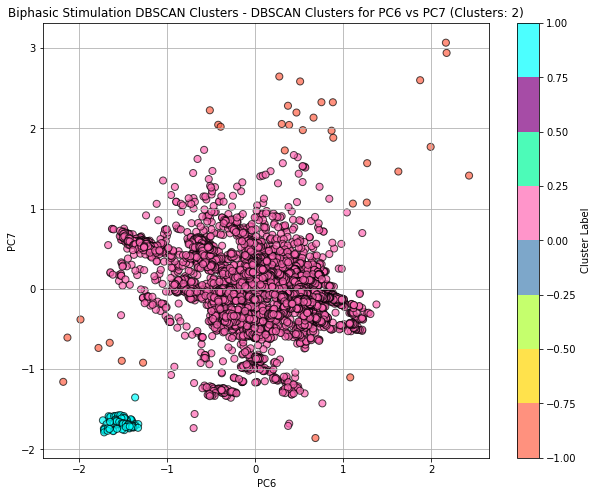

DBSCAN for PC6 vs PC7: 2 clusters, silhouette score: 0.58


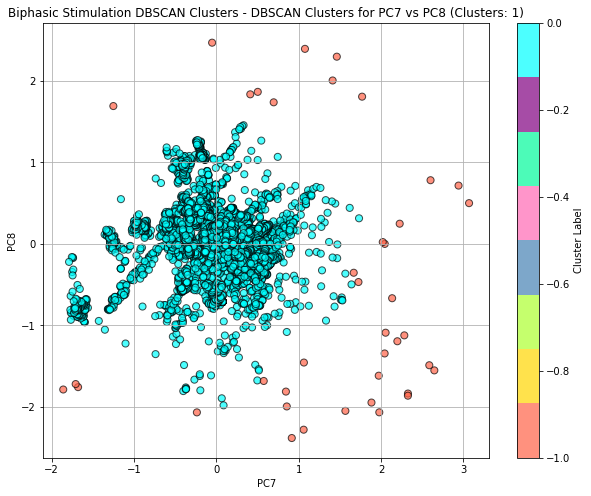

DBSCAN for PC7 vs PC8: 1 clusters, silhouette score: -1.00


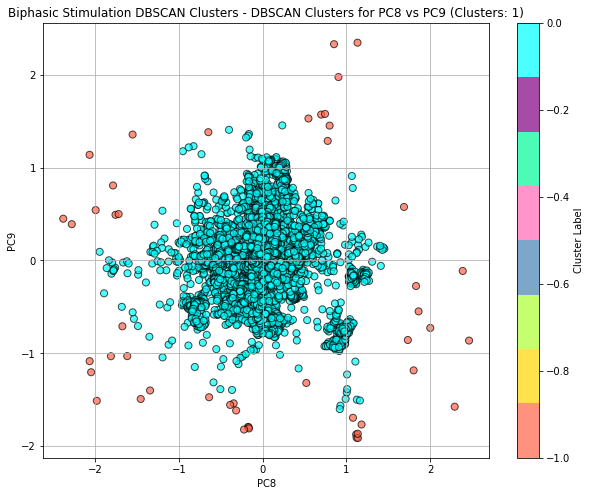

DBSCAN for PC8 vs PC9: 1 clusters, silhouette score: -1.00


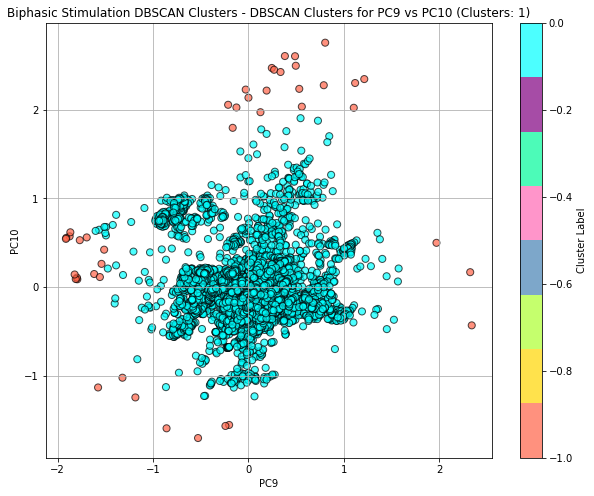

DBSCAN for PC9 vs PC10: 1 clusters, silhouette score: -1.00


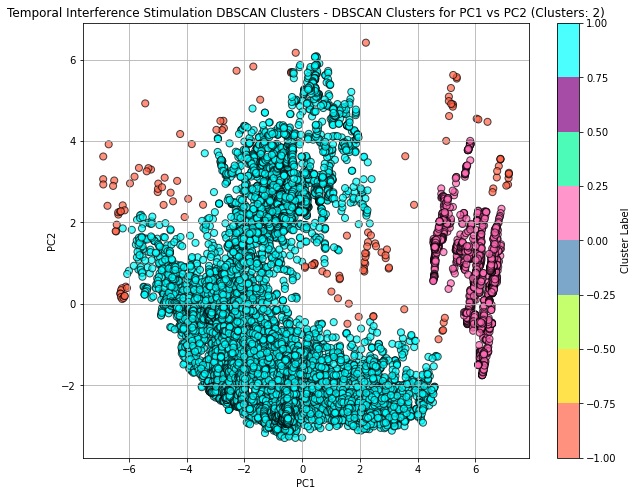

DBSCAN for PC1 vs PC2: 2 clusters, silhouette score: 0.37


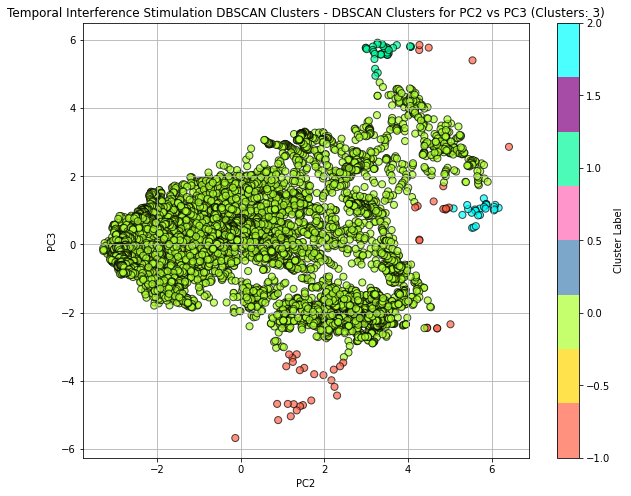

DBSCAN for PC2 vs PC3: 3 clusters, silhouette score: 0.31


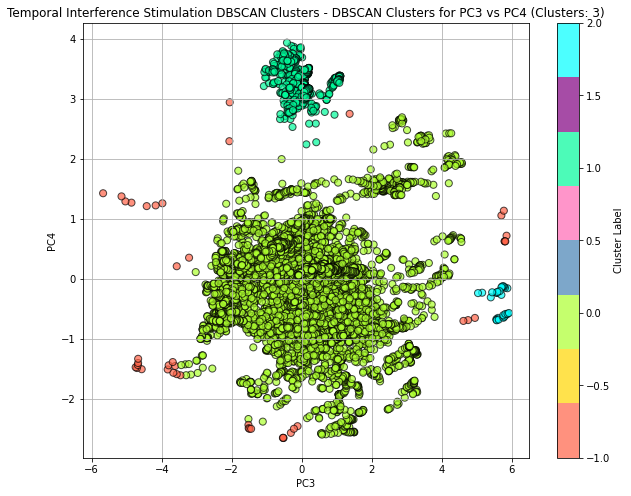

DBSCAN for PC3 vs PC4: 3 clusters, silhouette score: 0.46


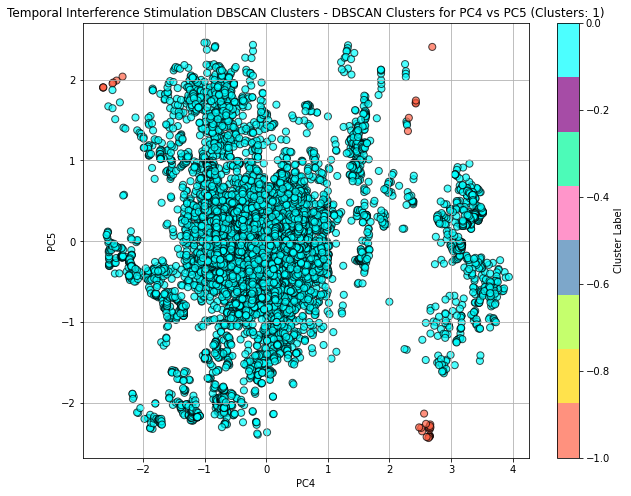

DBSCAN for PC4 vs PC5: 1 clusters, silhouette score: -1.00


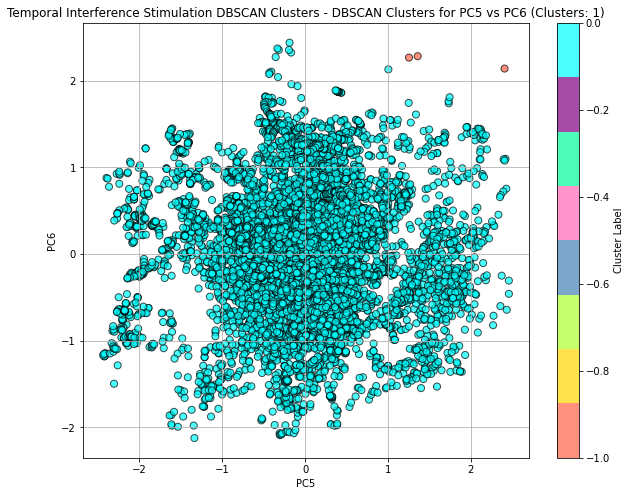

DBSCAN for PC5 vs PC6: 1 clusters, silhouette score: -1.00


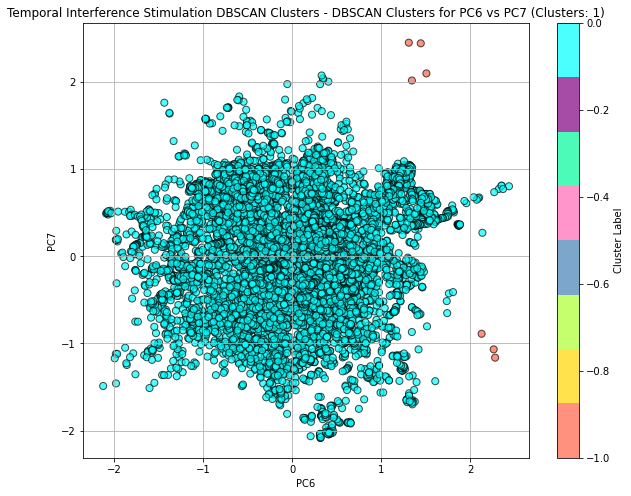

DBSCAN for PC6 vs PC7: 1 clusters, silhouette score: -1.00


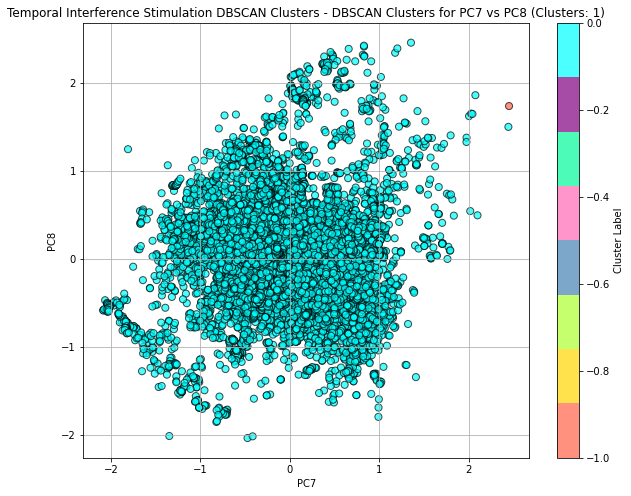

DBSCAN for PC7 vs PC8: 1 clusters, silhouette score: -1.00


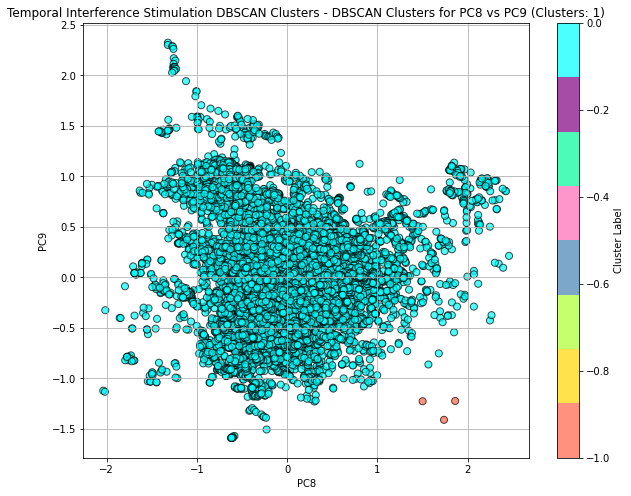

DBSCAN for PC8 vs PC9: 1 clusters, silhouette score: -1.00


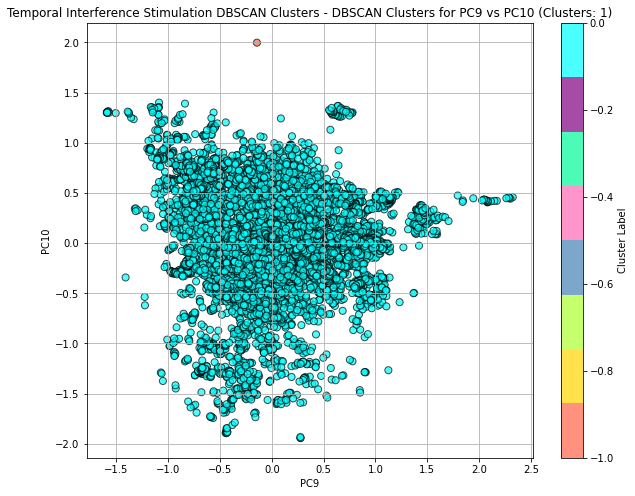

DBSCAN for PC9 vs PC10: 1 clusters, silhouette score: -1.00


In [181]:
# # DBSCAN Clustering
# from sklearn.cluster import DBSCAN

# def plot_dbscan_clusters(data, title, eps, min_samples):
#     pc_combinations = [('PC1', 'PC2'), ('PC2', 'PC3'), ('PC3', 'PC4'), ('PC4', 'PC5'), 
#                        ('PC5', 'PC6'), ('PC6', 'PC7'), ('PC7', 'PC8'), ('PC8', 'PC9'), ('PC9', 'PC10')]
#     # os.makedirs(output_folder, exist_ok=True)  # Ensure the directory exists

#     for pc1, pc2 in pc_combinations:
#         pca_data = data[[pc1, pc2]]
#         dbscan = DBSCAN(eps=eps, min_samples=min_samples)
#         cluster_labels = dbscan.fit_predict(pca_data)

#         # Check the number of clusters formed, minus one for noise if present
#         n_clusters_ = len(set(cluster_labels)) - (1 if -1 in cluster_labels else 0)
        
#         # Compute silhouette score only if more than 1 cluster and less than len(data)
#         if 1 < n_clusters_ < len(pca_data):
#             silhouette_avg = silhouette_score(pca_data, cluster_labels)
#         else:
#             silhouette_avg = -1

#         cmap = ListedColormap(['#FF6347', '#FFD700', '#ADFF2F', '#4682B4', '#FF69B4', '#00FA9A', '#800080', '#00FFFF'])
        
#         plt.figure(figsize=(10, 8))
#         scatter = plt.scatter(pca_data.iloc[:, 0], pca_data.iloc[:, 1], c=cluster_labels, cmap=cmap, marker='o', edgecolor='k', s=50, alpha=0.7)
#         plt.title(f'{title} - DBSCAN Clusters for {pc1} vs {pc2} (Clusters: {n_clusters_})')
#         plt.xlabel(pc1)
#         plt.ylabel(pc2)
#         plt.colorbar(scatter, label='Cluster Label')
#         plt.grid(True)
#         plt.show()

#         # figure_path = os.path.join(output_folder, f'dbscan_clusters_{pc1}_{pc2}.png')
#         # plt.savefig(figure_path)
#         # plt.close()

#         print(f"DBSCAN for {pc1} vs {pc2}: {n_clusters_} clusters, silhouette score: {silhouette_avg:.2f}")

# # Usage Example
# # output_folder_bis = '/path/to/output/directory/bis_sti'
# # output_folder_tis = '/path/to/output/directory/tis_sti'

# plot_dbscan_clusters(bis_principal_df, 'Biphasic Stimulation DBSCAN Clusters', eps=0.4, min_samples=20)
# plot_dbscan_clusters(tis_principal_df, 'Temporal Interference Stimulation DBSCAN Clusters', eps=0.5, min_samples=20)


In [172]:
from sklearn.cluster import DBSCAN

def apply_dbscan(data, eps, min_samples):
    # Apply DBSCAN to the dataset
    dbscan = DBSCAN(eps=eps, min_samples=min_samples)
    cluster_labels = dbscan.fit_predict(data[['PC1', 'PC2']])  
    data['Cluster'] = cluster_labels  # Append cluster labels to the dataframe
    return data

# Apply DBSCAN to BIS and TIS principal component dataframes
bis_dbscan_df = apply_dbscan(bis_principal_df)
tis_dbscan_df = apply_dbscan(tis_principal_df)

bis_dbscan_df

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,label,Cluster
0,0.915684,1.288018,1.177655,1.055101,-2.954588,0.620011,0.043094,-0.514692,-0.411581,0.036370,biphasic_stim(Batch1),0
1,0.662898,1.328195,1.193802,0.684074,-2.930894,0.362341,0.337891,-0.213825,-0.288500,0.121061,biphasic_stim(Batch1),0
2,0.598064,1.326489,1.198452,0.721962,-2.909891,0.380301,0.335739,-0.186927,-0.290753,0.133785,biphasic_stim(Batch1),0
3,0.581790,1.327664,1.182214,0.734076,-2.901286,0.386162,0.342620,-0.185791,-0.278857,0.151891,biphasic_stim(Batch1),0
4,0.684983,1.326375,1.025649,0.935381,-2.885814,0.378402,0.262745,-0.298653,-0.313719,0.101725,biphasic_stim(Batch1),0
...,...,...,...,...,...,...,...,...,...,...,...,...
5520,-0.345479,0.250483,-1.586006,-0.969935,0.075538,-1.388248,-1.725549,-0.770750,-0.681241,0.169932,biphasic_stim(Batch3),0
5521,-0.360946,0.257444,-1.585223,-0.982824,0.072780,-1.392930,-1.712168,-0.758574,-0.686750,0.174199,biphasic_stim(Batch3),0
5522,-0.439042,0.349569,-1.529379,-0.968505,0.069345,-1.400467,-1.722859,-0.797378,-0.629886,0.170872,biphasic_stim(Batch3),0
5523,-0.360070,0.312898,-1.510282,-0.982030,0.083962,-1.427617,-1.715186,-0.788763,-0.657551,0.226090,biphasic_stim(Batch3),0


For n_clusters = 2, the average silhouette score is : 0.32354542317292423
For n_clusters = 3, the average silhouette score is : 0.3338671578543598
For n_clusters = 4, the average silhouette score is : 0.3711441692028849
For n_clusters = 5, the average silhouette score is : 0.33707270750540763
For n_clusters = 6, the average silhouette score is : 0.35739485084227157
For n_clusters = 7, the average silhouette score is : 0.33860292458900654
For n_clusters = 8, the average silhouette score is : 0.32320569819562467
For n_clusters = 9, the average silhouette score is : 0.33036588965929437
For n_clusters = 10, the average silhouette score is : 0.32758347307073843
For n_clusters = 11, the average silhouette score is : 0.34476069494061673
For n_clusters = 12, the average silhouette score is : 0.35761991671818405
For n_clusters = 13, the average silhouette score is : 0.36278904882734714
For n_clusters = 14, the average silhouette score is : 0.37122123145209335
For n_clusters = 15, the average si

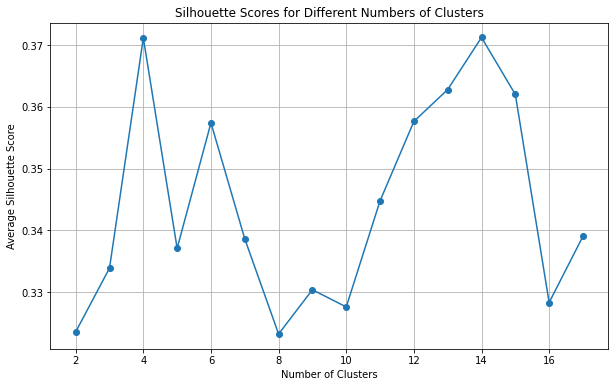

In [126]:
from sklearn.metrics import silhouette_score
from sklearn.cluster import KMeans

# Define a range of possible clusters to evaluate
range_n_clusters = list(range(2, 18))  
silhouette_avg_scores = []

# Loop through the number of clusters
for n_clusters in range_n_clusters:
    # Perform K-means clustering
    kmeans = KMeans(n_clusters=n_clusters, random_state=42)
    cluster_labels = kmeans.fit_predict(principal_df)
    
    # Calculate the silhouette score
    silhouette_avg = silhouette_score(principal_df, cluster_labels)
    silhouette_avg_scores.append(silhouette_avg)
    print(f"For n_clusters = {n_clusters}, the average silhouette score is : {silhouette_avg}")

# Plotting the silhouette scores
plt.figure(figsize=(10, 6))
plt.plot(range_n_clusters, silhouette_avg_scores, marker='o')
plt.title('Silhouette Scores for Different Numbers of Clusters')
plt.xlabel('Number of Clusters')
plt.ylabel('Average Silhouette Score')
plt.grid(True)
plt.show()

Optimal number of clusters based on silhouette score: 14


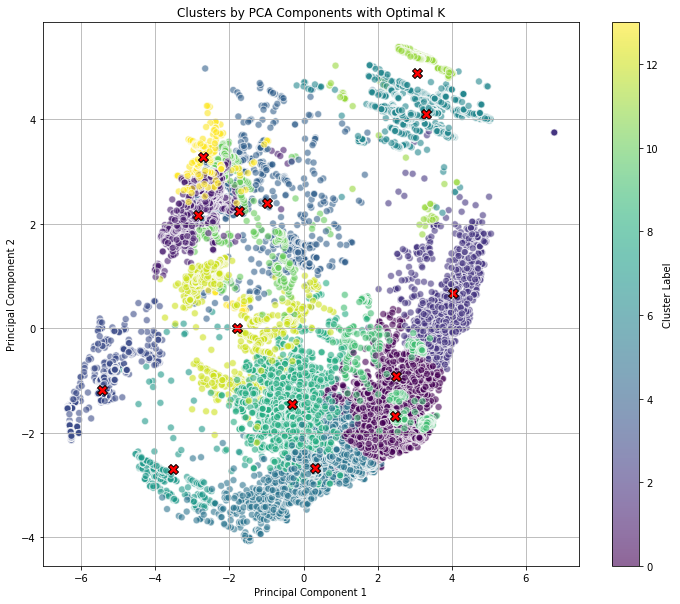

In [42]:
# Choosing the optimal number of clusters
optimal_clusters = range_n_clusters[np.argmax(silhouette_avg_scores)]
print(f"Optimal number of clusters based on silhouette score: {optimal_clusters}")

# Applying K-means clustering with the optimal number of clusters
kmeans_optimal = KMeans(n_clusters=optimal_clusters, random_state=42)
kmeans_optimal.fit(principal_df)
principal_df['Cluster'] = kmeans_optimal.labels_

# Improved plot settings
plt.figure(figsize=(12, 10))
scatter = plt.scatter(principal_df['PC1'], principal_df['PC2'], c=principal_df['Cluster'], 
                      cmap='viridis', alpha=0.6, edgecolor='w', s=50)  
centers = kmeans_optimal.cluster_centers_
plt.scatter(centers[:, 0], centers[:, 1], c='red', s=100, marker='X', edgecolors='black')  # Enhanced centroids
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.title('Clusters by PCA Components with Optimal K')
plt.colorbar(scatter, label='Cluster Label')
plt.grid(True)  # Ensuring grid is on for better alignment
plt.show()

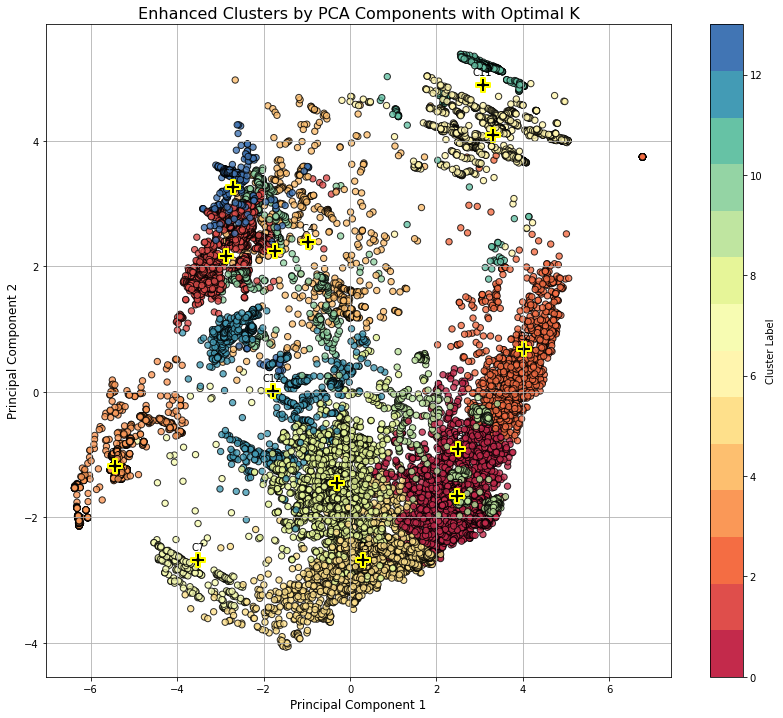

In [46]:
from matplotlib.colors import ListedColormap
# Customizing the color map

cmap = ListedColormap(sns.color_palette("Spectral", n_colors=14))  # Adjust the number of colors as needed

# Plot the clusters with enhanced visualization settings
plt.figure(figsize=(14, 12))  # Slightly larger plot for better visibility
scatter = plt.scatter(principal_df['PC1'], principal_df['PC2'],
                      c=principal_df['Cluster'], cmap=cmap,
                      alpha=0.8, edgecolor='k', s=40)  # More opaque and smaller edges

# Drawing centroids with a clear distinction
centers = kmeans_optimal.cluster_centers_
plt.scatter(centers[:, 0], centers[:, 1], c='black', s=200, marker='P', edgecolors='yellow', linewidths=2)


cbar = plt.colorbar(scatter, label='Cluster Label')
cbar.set_alpha(1)
cbar.draw_all()


plt.xlabel('Principal Component 1', fontsize=12)
plt.ylabel('Principal Component 2', fontsize=12)
plt.title('Enhanced Clusters by PCA Components with Optimal K', fontsize=16)
plt.grid(True)  # Enhanced grid visibility


for i, txt in enumerate(range(len(centers))):
    plt.annotate(f'C{txt}', (centers[i, 0], centers[i, 1]), textcoords="offset points", xytext=(0,10), ha='center')

plt.show()

Optimal number of clusters based on silhouette score: 14


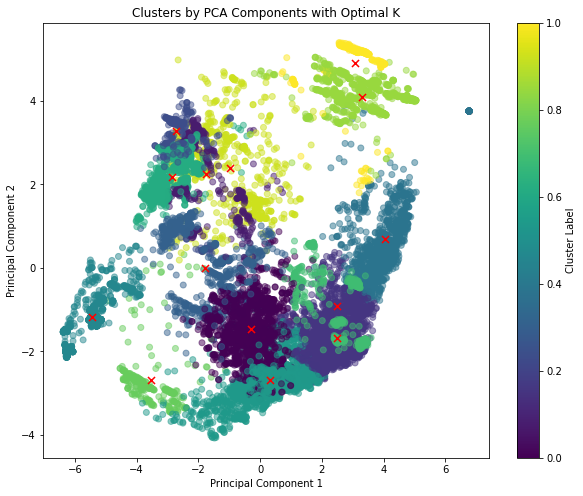

In [39]:
# Choosing the optimal number of clusters
optimal_clusters = range_n_clusters[np.argmax(silhouette_avg_scores)]
print(f"Optimal number of clusters based on silhouette score: {optimal_clusters}")

# Applying K-means clustering with the optimal number of clusters
kmeans_optimal = KMeans(n_clusters=optimal_clusters, random_state=42)
kmeans_optimal.fit(principal_df)
principal_df['Cluster'] = kmeans_optimal.labels_

# Plot the clusters
plt.figure(figsize=(10, 8))
plt.scatter(principal_df['PC1'], principal_df['PC2'], c=principal_df['Cluster'], cmap='viridis', alpha=0.5)
centers = kmeans_optimal.cluster_centers_
plt.scatter(centers[:, 0], centers[:, 1], c='red', s=50, marker='x')  # Plot centroids
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.title('Clusters by PCA Components with Optimal K')
plt.colorbar(label='Cluster Label')
plt.show()


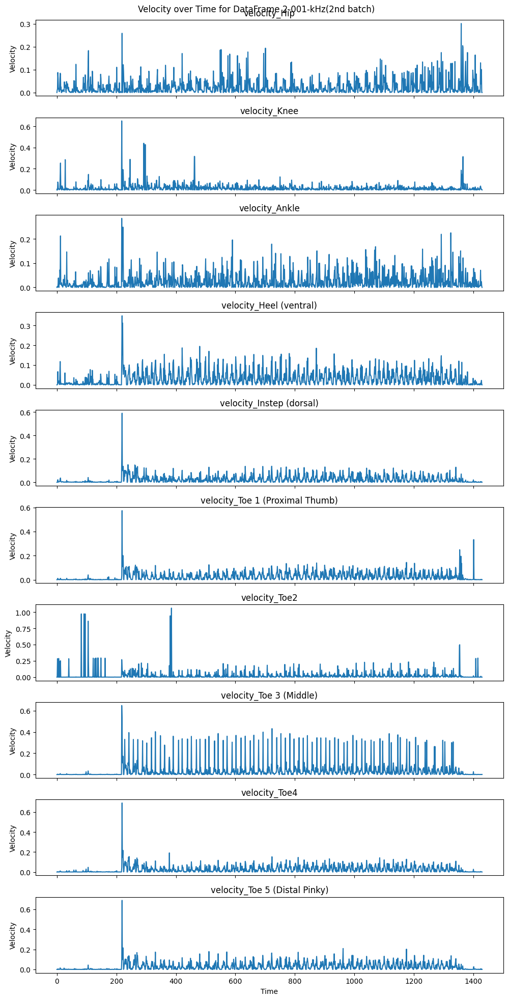

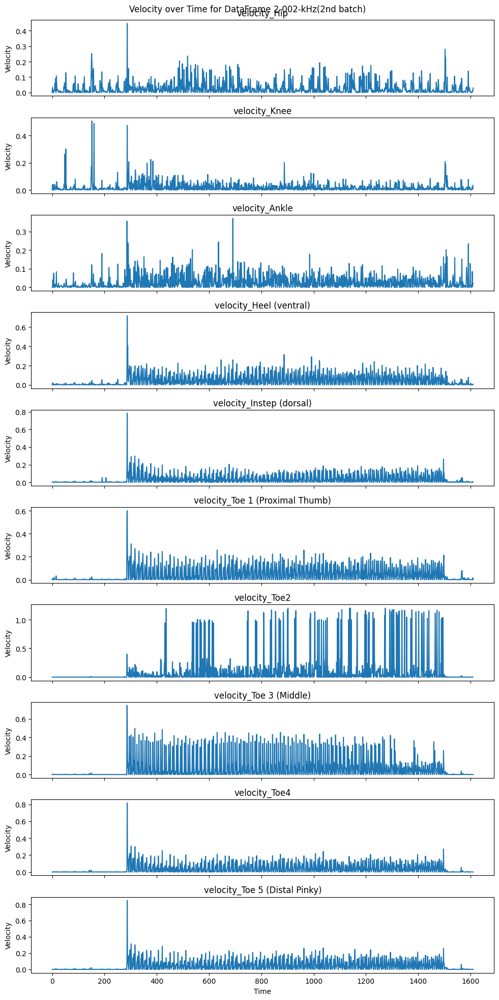

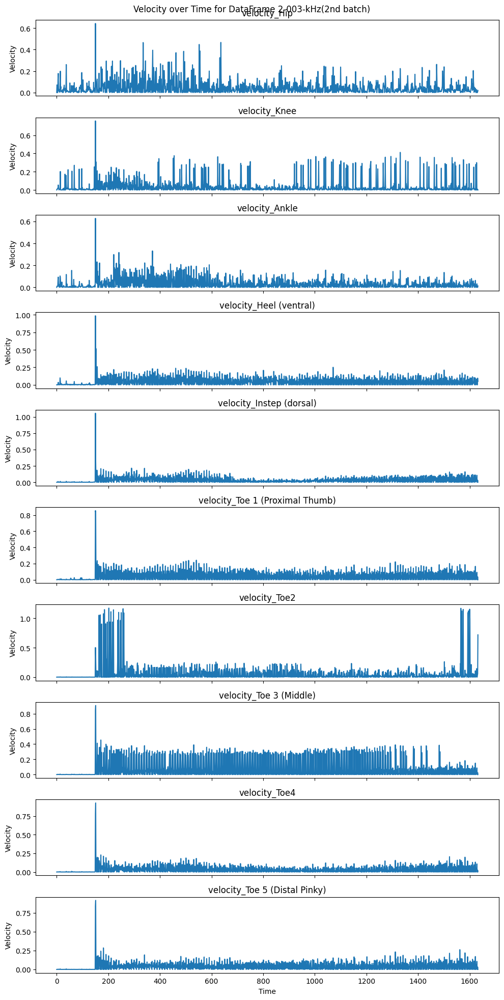

In [ ]:
def plot_velocity_subplots(velocity_df, title):
    num_plots = len(velocity_df.columns)
    fig, axes = plt.subplots(num_plots, 1, figsize=(10, num_plots * 2), sharex=True)

    for i, column in enumerate(velocity_df.columns):
        axes[i].plot(velocity_df[column])
        axes[i].set_title(column)
        axes[i].set_ylabel('Velocity')

    axes[-1].set_xlabel('Time')
    plt.suptitle(title)
    plt.tight_layout()
    plt.show()

# Call the function for one of the dataframes
plot_velocity_subplots(velocity_df1, 'Velocity over Time for DataFrame 2-001-kHz(2nd batch)')
plot_velocity_subplots(velocity_df2, 'Velocity over Time for DataFrame 2-002-kHz(2nd batch)')
plot_velocity_subplots(velocity_df3, 'Velocity over Time for DataFrame 2-003-kHz(2nd batch)')


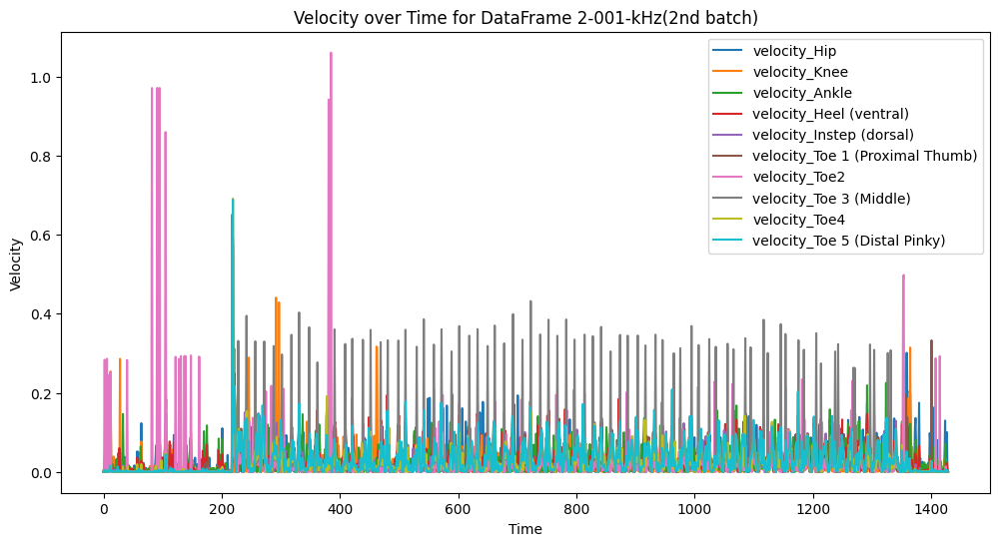

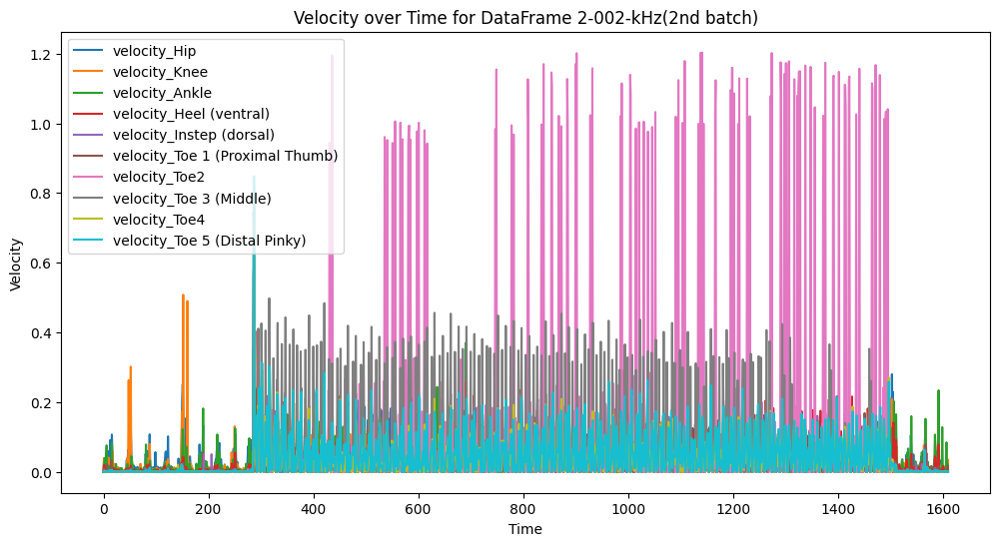

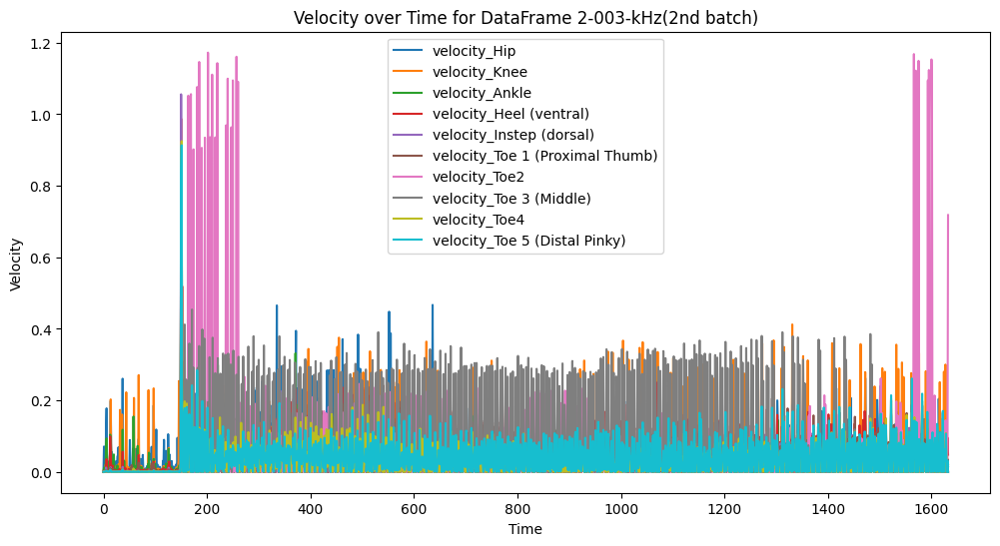

### Correlation

#### Correlation of body parts x,y

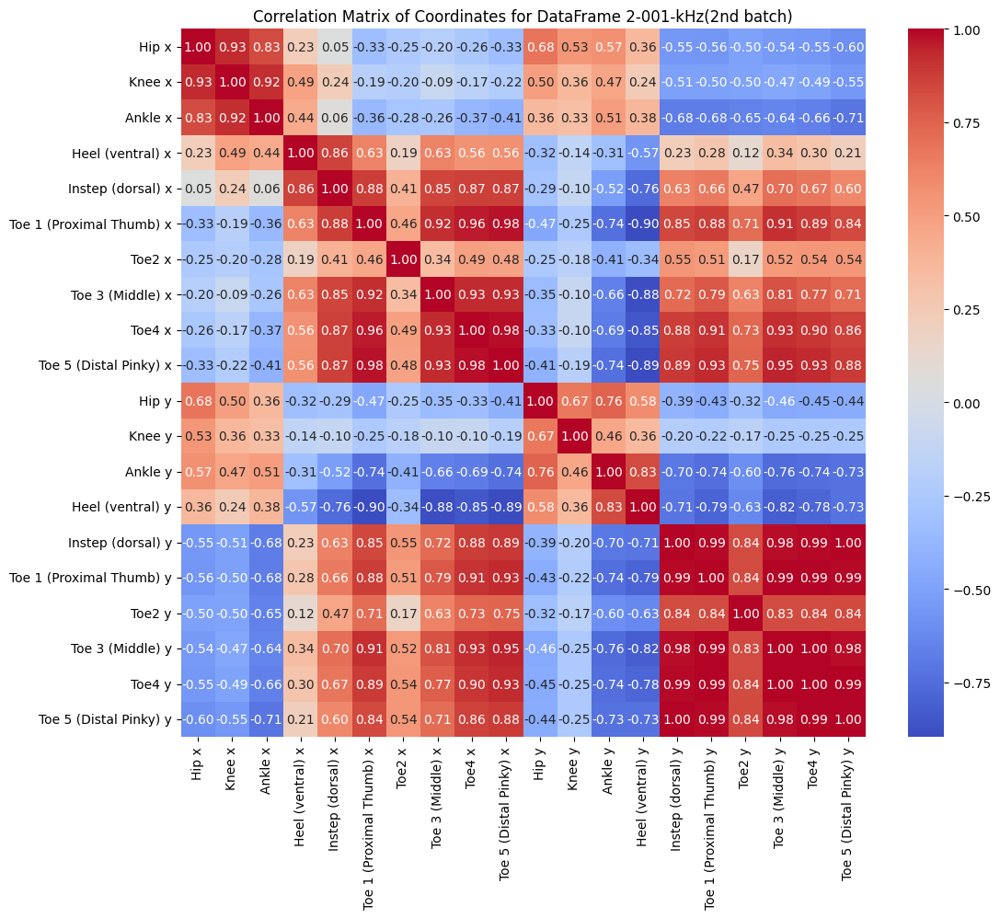

In [ ]:
# Plotting the correlation matrix using seaborn
plt.figure(figsize=(12,10))
sns.heatmap(correlations_xy_df1, annot=True, fmt=".2f", cmap="coolwarm")
plt.title("Correlation Matrix of Coordinates for DataFrame 2-001-kHz(2nd batch)")
plt.show()

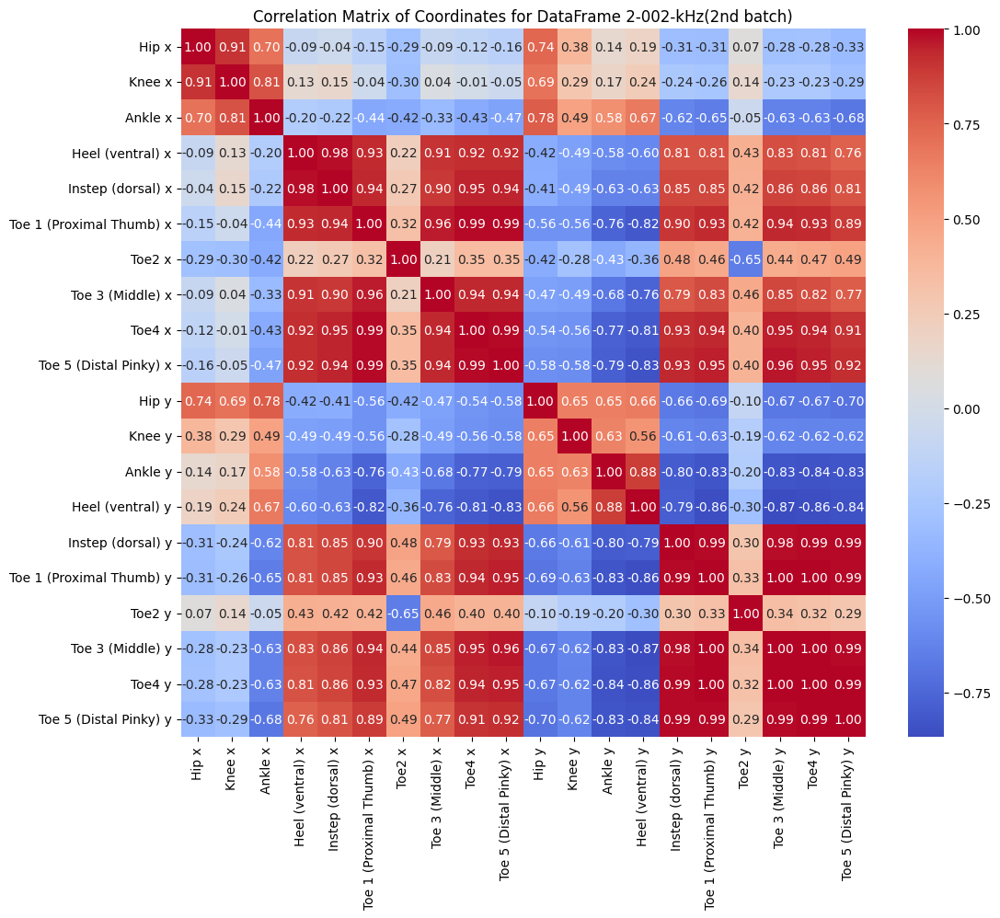

In [ ]:
# Plotting the correlation matrix using seaborn
plt.figure(figsize=(12,10))
sns.heatmap(correlations_xy_df2, annot=True, fmt=".2f", cmap="coolwarm")
plt.title("Correlation Matrix of Coordinates for DataFrame 2-002-kHz(2nd batch)")
plt.show()

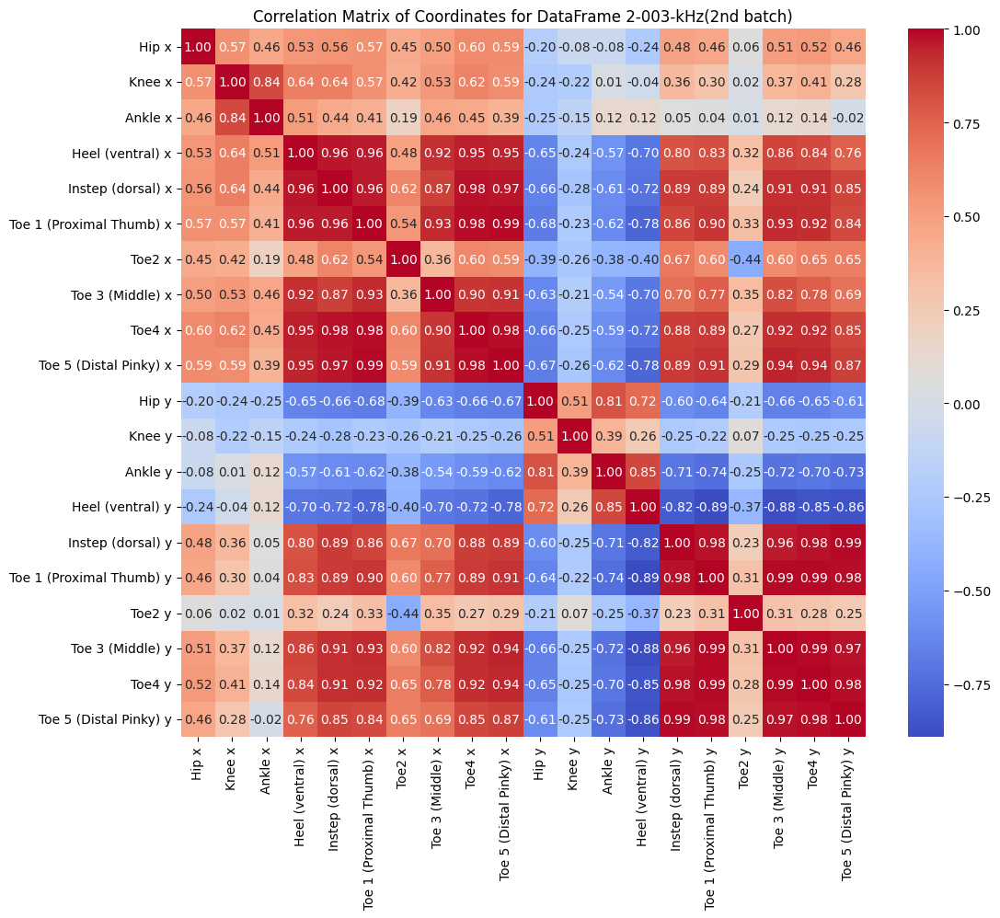

In [ ]:
# Plotting the correlation matrix using seaborn
plt.figure(figsize=(12,10))
sns.heatmap(correlations_xy_df3, annot=True, fmt=".2f", cmap="coolwarm")
plt.title("Correlation Matrix of Coordinates for DataFrame 2-003-kHz(2nd batch)")
plt.show()

### Correlation of comparison between different dataset

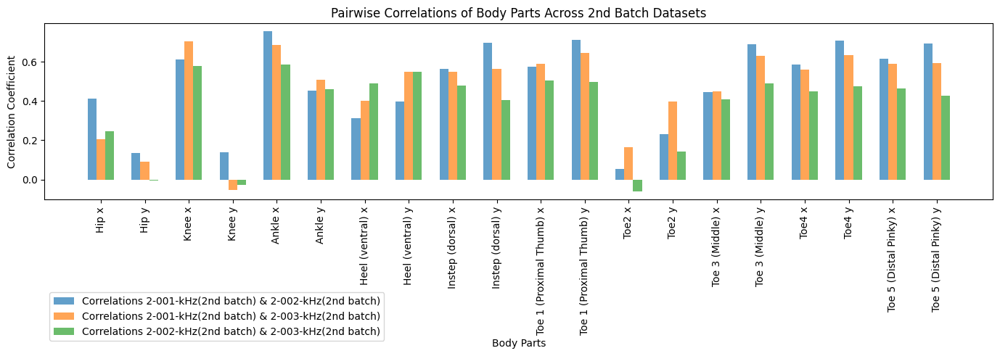

In [ ]:
# Set the positions and width for the bars
positions = list(range(len(correlations_1_2)))
width = 0.2

# Plotting the correlations in a bar chart
plt.figure(figsize=(14, 6))

plt.bar([p - width for p in positions], correlations_1_2, width, alpha=0.7, label='Correlations 2-001-kHz(2nd batch) & 2-002-kHz(2nd batch)')
plt.bar(positions, correlations_1_3, width, alpha=0.7, label='Correlations 2-001-kHz(2nd batch) & 2-003-kHz(2nd batch)')
plt.bar([p + width for p in positions], correlations_2_3, width, alpha=0.7, label='Correlations 2-002-kHz(2nd batch) & 2-003-kHz(2nd batch)')


plt.xlabel('Body Parts')
plt.ylabel('Correlation Coefficient')
plt.title('Pairwise Correlations of Body Parts Across 2nd Batch Datasets')

# Adding the legend and showing the plot
plt.legend(loc='upper left', bbox_to_anchor=(0,-0.5))
plt.xticks(positions, correlations_1_2.index, rotation='vertical')
plt.tight_layout()  

# Show the plot
plt.show()

### Euclidean Distance 

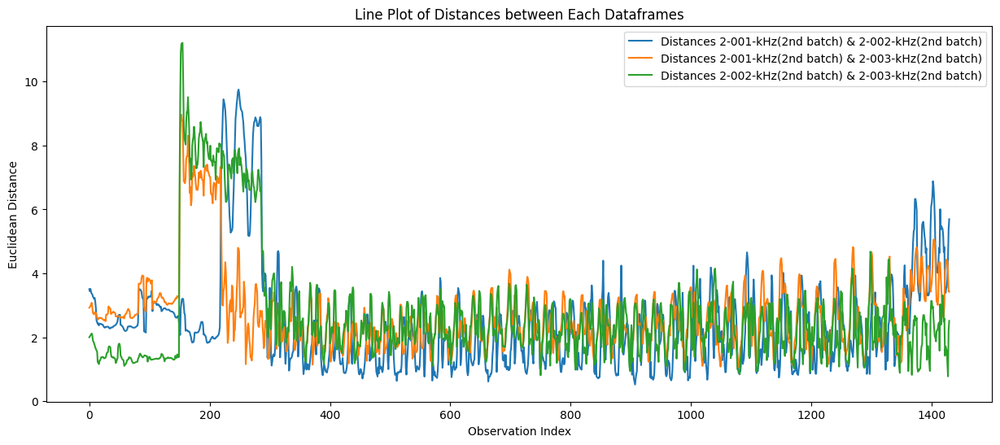

In [ ]:
plt.style.use('default')
import matplotlib.pyplot as plt

plt.figure(figsize=(15, 6))
for distances, label in zip([total_distances_1_2, total_distances_1_3, total_distances_2_3], 
                            ['2-001-kHz(2nd batch) & 2-002-kHz(2nd batch)', 
                             '2-001-kHz(2nd batch) & 2-003-kHz(2nd batch)', 
                             '2-002-kHz(2nd batch) & 2-003-kHz(2nd batch)']):
    plt.plot(distances, label=f'Distances {label}')
plt.title('Line Plot of Distances between Each Dataframes')
plt.xlabel('Observation Index')
plt.ylabel('Euclidean Distance')
plt.legend()
plt.show()


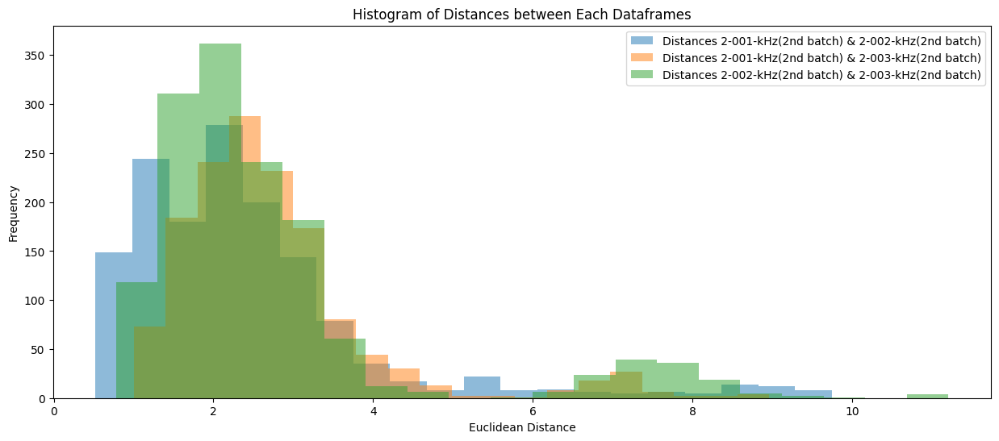

In [ ]:
plt.figure(figsize=(15, 6))
for distances, label in zip([total_distances_1_2, total_distances_1_3, total_distances_2_3], 
                            ['2-001-kHz(2nd batch) & 2-002-kHz(2nd batch)', 
                             '2-001-kHz(2nd batch) & 2-003-kHz(2nd batch)', 
                             '2-002-kHz(2nd batch) & 2-003-kHz(2nd batch)']):
    plt.hist(distances, bins=20, alpha=0.5, label=f'Distances {label}')
plt.title('Histogram of Distances between Each Dataframes')
plt.xlabel('Euclidean Distance')
plt.ylabel('Frequency')
plt.legend()
plt.show()


Dynamic Time Warping (DTW): measuring similarity between two temporal sequences which may vary in speed. For example, if one rat moves more slowly than another but the sequence of movements is the same, DTW can detect this similarity despite the difference in timing. This could be particularly useful if the effects of different frequencies on the timing of movements are of interest.

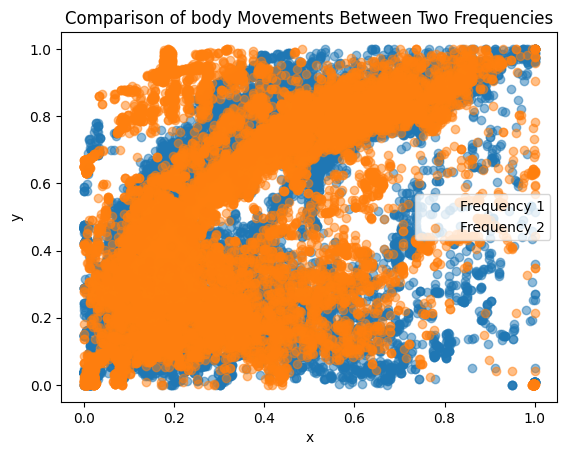

In [72]:
import matplotlib.pyplot as plt

# Example for 'Hip x' and 'Hip y' coordinates
plt.scatter(x_df1, y_df1, alpha=0.5, label='Frequency 1')
plt.scatter(x_df2, y_df2, alpha=0.5, label='Frequency 2')
plt.legend()
plt.xlabel('x')
plt.ylabel('y')
plt.title('Comparison of body Movements Between Two Frequencies')
plt.show()
